In [61]:
import pandas as pd
import numpy as np
from sklearn.datasets import make_classification
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from imblearn.over_sampling import SMOTE 
from collections import Counter



In [62]:
all_data = pd.read_csv(r'/Users/ihteshamshah/Desktop/Postdoc/Dataset/NKR_IKNL_breast_syntheticdata.csv')
all_data.head()

,key_nkr,key_eid,leeft,gesl,incjr,vit_stat,vit_stat_int,tumsoort,diag_basis,topo,...,okd,org_chir,uitgebr_chir_code,dir_reconstr,chemo,target,horm,rt,meta_rt,meta_chir
0,FAKE_PATIENT_1,FAKE_EPISODE_1,93,2,2013,1,390,501300,7,C50,...,0,1,NaN,0,0,4,0,0,0,0
1,FAKE_PATIENT_2,FAKE_EPISODE_2,60,2,2010,0,3592,503200,2,C50,...,0,0,131C50,1,1,0,2,2,0,0
2,FAKE_PATIENT_3,FAKE_EPISODE_3,43,2,2010,0,4011,502200,7,C50,...,0,1,NaN,0,0,0,0,0,0,0
3,FAKE_PATIENT_4,FAKE_EPISODE_4,38,2,2012,0,2811,501300,7,C50,...,0,1,131C50,0,0,0,0,2,0,0
4,FAKE_PATIENT_5,FAKE_EPISODE_5,29,2,2019,0,724,501300,7,C50,...,0,1,131C50,0,0,0,2,2,0,0


In [63]:
DataSet= all_data[['leeft' ,'gesl', 'tumsoort', 'diag_basis', 'topo', 'topo_sublok', 'later', 'morf', 'ct', 'cn', 'cm', 'cstadium', 'er_stat', 'pr_stat', 'her2_stat', 'dcis_comp', 'multifoc','chemo', 'target', 'horm', 'rt', 'meta_chir']]


DataSet['her2_stat'].unique()

array([ 3., nan,  1.,  0.,  2.,  7.,  4.,  9.])

In [64]:
DataSet.columns = ['Age_at_incidence_date', 'Sex', 
                'Tumor_type', 'Basis_for_diagnosis', 'Topography_excluding', 
                'Topography_including', 'Lateralization', 'Morphology', 'cT_TNM', 'cN_TNM', 'cm_TNM',
                'Stage_based_on_cTNM', 'Er_status', 'Pr_status', 'HER2_state', 'DCIS_component',
                  'Tumor_multifocality', 'chemo','target','hormonal','radio','surgery']
DataSet.head()

,Age_at_incidence_date,Sex,Tumor_type,Basis_for_diagnosis,Topography_excluding,Topography_including,Lateralization,Morphology,cT_TNM,cN_TNM,...,Er_status,Pr_status,HER2_state,DCIS_component,Tumor_multifocality,chemo,target,hormonal,radio,surgery
0,93,2,501300,7,C50,C508,1.0,8500,1C,0,...,1.0,0.0,3.0,0.0,0.0,0,4,0,0,0
1,60,2,503200,2,C50,C505,1.0,8520,1C,0,...,1.0,NaN,NaN,NaN,1.0,1,0,2,2,0
2,43,2,502200,7,C50,C508,2.0,8500,IS,0,...,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0
3,38,2,501300,7,C50,C504,1.0,8481,1B,0,...,1.0,1.0,1.0,1.0,0.0,0,0,0,2,0
4,29,2,501300,7,C50,C504,2.0,8500,1C,0,...,1.0,1.0,1.0,1.0,0.0,0,0,2,2,0


In [65]:
DataSet.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Age_at_incidence_date  60000 non-null  int64  
 1   Sex                    60000 non-null  int64  
 2   Tumor_type             60000 non-null  int64  
 3   Basis_for_diagnosis    60000 non-null  int64  
 4   Topography_excluding   60000 non-null  object 
 5   Topography_including   60000 non-null  object 
 6   Lateralization         58391 non-null  float64
 7   Morphology             60000 non-null  int64  
 8   cT_TNM                 59096 non-null  object 
 9   cN_TNM                 59131 non-null  object 
 10  cm_TNM                 57404 non-null  float64
 11  Stage_based_on_cTNM    58835 non-null  object 
 12  Er_status              53470 non-null  float64
 13  Pr_status              53809 non-null  float64
 14  HER2_state             52552 non-null  float64
 15  DC

In [66]:
DataSet.Basis_for_diagnosis.unique()

array([7, 2, 6, 5])

In [67]:
#data.drop(['Stage_based_on_pTNM_supplemented_with_cTNM', 'pN_TNM', 'pT_TNM' ,'cT_TNM', 'cN_TNM', 'Stage_based_on_pTNM','Stage_based_on_cTNM','Key_number_patient','Topography_including_sublocalization', 'Results_of_sentinel_lymph_node_procedure', 'Result_of_MARI_procedure','MARI_procedure_performed','Incidence_year','Key_number_tumor', 'Topography_excluding_sublocalization', 'Code_of_most_extensive_surgery'], axis=1, inplace = True)
#data.head()

In [68]:
#data.info(verbose=True)

In [69]:
DataSet.dropna(inplace=True)
DataSet.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 39510 entries, 0 to 59999
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Age_at_incidence_date  39510 non-null  int64  
 1   Sex                    39510 non-null  int64  
 2   Tumor_type             39510 non-null  int64  
 3   Basis_for_diagnosis    39510 non-null  int64  
 4   Topography_excluding   39510 non-null  object 
 5   Topography_including   39510 non-null  object 
 6   Lateralization         39510 non-null  float64
 7   Morphology             39510 non-null  int64  
 8   cT_TNM                 39510 non-null  object 
 9   cN_TNM                 39510 non-null  object 
 10  cm_TNM                 39510 non-null  float64
 11  Stage_based_on_cTNM    39510 non-null  object 
 12  Er_status              39510 non-null  float64
 13  Pr_status              39510 non-null  float64
 14  HER2_state             39510 non-null  float64
 15  DCIS_co


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [70]:
data = pd.get_dummies(DataSet, drop_first = True) #drop_first= ture prevents from dummy trap and it delete the first column.
data.head()

,Age_at_incidence_date,Sex,Tumor_type,Basis_for_diagnosis,Lateralization,Morphology,cm_TNM,Er_status,Pr_status,HER2_state,...,cN_TNM_3B,cN_TNM_3C,Stage_based_on_cTNM_1A,Stage_based_on_cTNM_2A,Stage_based_on_cTNM_2B,Stage_based_on_cTNM_3A,Stage_based_on_cTNM_3B,Stage_based_on_cTNM_3C,Stage_based_on_cTNM_4,Stage_based_on_cTNM_M
0,93,2,501300,7,1.0,8500,0.0,1.0,0.0,3.0,...,False,False,True,False,False,False,False,False,False,False
3,38,2,501300,7,1.0,8481,0.0,1.0,1.0,1.0,...,False,False,True,False,False,False,False,False,False,False
4,29,2,501300,7,2.0,8500,0.0,1.0,1.0,1.0,...,False,False,True,False,False,False,False,False,False,False
5,82,2,501300,7,1.0,8500,0.0,1.0,1.0,0.0,...,False,False,False,False,True,False,False,False,False,False
6,67,2,501300,7,2.0,8501,0.0,1.0,1.0,0.0,...,False,False,False,False,True,False,False,False,False,False


In [71]:

data.reset_index(drop=True, inplace=True)
DATA=data #for later use when dealing with imbalance dataset (weight and smote methods)

In [72]:
data.head()

,Age_at_incidence_date,Sex,Tumor_type,Basis_for_diagnosis,Lateralization,Morphology,cm_TNM,Er_status,Pr_status,HER2_state,...,cN_TNM_3B,cN_TNM_3C,Stage_based_on_cTNM_1A,Stage_based_on_cTNM_2A,Stage_based_on_cTNM_2B,Stage_based_on_cTNM_3A,Stage_based_on_cTNM_3B,Stage_based_on_cTNM_3C,Stage_based_on_cTNM_4,Stage_based_on_cTNM_M
0,93,2,501300,7,1.0,8500,0.0,1.0,0.0,3.0,...,False,False,True,False,False,False,False,False,False,False
1,38,2,501300,7,1.0,8481,0.0,1.0,1.0,1.0,...,False,False,True,False,False,False,False,False,False,False
2,29,2,501300,7,2.0,8500,0.0,1.0,1.0,1.0,...,False,False,True,False,False,False,False,False,False,False
3,82,2,501300,7,1.0,8500,0.0,1.0,1.0,0.0,...,False,False,False,False,True,False,False,False,False,False
4,67,2,501300,7,2.0,8501,0.0,1.0,1.0,0.0,...,False,False,False,False,True,False,False,False,False,False


In [73]:

X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
X.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39510 entries, 0 to 39509
Data columns (total 46 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Age_at_incidence_date      39510 non-null  int64  
 1   Sex                        39510 non-null  int64  
 2   Tumor_type                 39510 non-null  int64  
 3   Basis_for_diagnosis        39510 non-null  int64  
 4   Lateralization             39510 non-null  float64
 5   Morphology                 39510 non-null  int64  
 6   cm_TNM                     39510 non-null  float64
 7   Er_status                  39510 non-null  float64
 8   Pr_status                  39510 non-null  float64
 9   HER2_state                 39510 non-null  float64
 10  DCIS_component             39510 non-null  float64
 11  Tumor_multifocality        39510 non-null  float64
 12  Topography_including_C501  39510 non-null  bool   
 13  Topography_including_C502  39510 non-null  boo

In [74]:
from sklearn.datasets import make_classification
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import shuffle
import numpy as np
#y1= data[['chemo']]
#y2=data[['target']]
#y3=data[['hormonal']]
#y4=data[['radio']]
#y5=data[['surgery']]



In [75]:
Y = data[['chemo','target','hormonal','radio','surgery']]
Y.head()

,chemo,target,hormonal,radio,surgery
0,0,4,0,0,0
1,0,0,0,2,0
2,0,0,2,2,0
3,2,2,2,0,0
4,0,0,0,0,0


In [76]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.2)

In [77]:
y_test

,chemo,target,hormonal,radio,surgery
13481,0,0,0,2,0
21184,2,0,0,2,0
21628,0,0,2,2,0
7272,2,0,0,0,0
37892,0,0,0,2,0
...,...,...,...,...,...
13503,2,0,2,2,0
38070,0,0,2,2,0
22855,0,0,0,2,0
36474,0,0,3,2,0


In [78]:
#above index are not uniform. reset the index because, next we need to itetrate algorithm on index to get the true class. 
y_test.reset_index(drop=True, inplace=True)
y_test.head(10)

,chemo,target,hormonal,radio,surgery
0,0,0,0,2,0
1,2,0,0,2,0
2,0,0,2,2,0
3,2,0,0,0,0
4,0,0,0,2,0
5,0,0,2,2,0
6,0,0,2,0,0
7,0,0,2,2,0
8,0,0,0,2,0
9,2,0,0,2,0


In [79]:
#[y_test[y_test.columns[0]][j]for j in range (len(y_test))]

In [80]:
### for imbalance datasets:

forest = RandomForestClassifier(random_state=1, class_weight='balanced_subsample')
multi_target_forest = MultiOutputClassifier(forest, n_jobs=2)
predicted_values= multi_target_forest.fit(x_train,y_train).predict(x_test)

In [81]:
predicted_values

array([[0, 0, 0, 2, 0],
       [0, 0, 2, 2, 0],
       [0, 0, 0, 0, 0],
       ...,
       [0, 0, 0, 2, 0],
       [0, 0, 2, 2, 0],
       [2, 3, 2, 0, 0]])

In [82]:


accuracies,precisions, recalls, f1_scores = [], [], [], []

for i in range(Y.shape[1]):
    
    # Calculate Accuracy separately for each labal
    y_pred=[predicted_values[j][i]for j in range(len(x_test))] #First column of each row contains the prediction values of first class("chemo" in this case) and so on...
    y_true=[y_test[y_test.columns[i]][j]for j in range (len(y_test))] # Y[Y.columns[i]][j]= Y['chemo'][0]--> Y.columns[i]= 'chemo','target',...
    accuracy = accuracy_score(y_pred, y_true) #accuracy of each class.
    accuracies.append(accuracy)
    
    # Calculate F1 score separately for each labal
    f1 = f1_score(y_true, y_pred, average='weighted')  # Use average='binary' for each output
    f1_scores.append(f1)
    
    precision = precision_score(y_true, y_pred, average='weighted')
    recall = recall_score(y_true, y_pred,average='weighted')
    precisions.append(precision)
    recalls.append(recall)
    

# Compute average accuracy across all outputs
average_accuracy = sum(accuracies) / len(accuracies)
average_precision = sum(precisions) / len(precisions)
average_recall = sum(recalls) / len(recalls)

# Compute average F1 score across all outputs
average_f1_score = sum(f1_scores) / len(f1_scores)

print("Accuracy Score for Multiclass-Multioutput:", average_accuracy)
print("F1 Score for Multiclass-Multioutput:", average_f1_score)
print("Average Precision:", average_precision)
print("Average Recall:", average_recall)

Accuracy Score for Multiclass-Multioutput: 0.65013920526449
F1 Score for Multiclass-Multioutput: 0.6197508431157324
Average Precision: 0.5980997628962472
Average Recall: 0.65013920526449


In [83]:
accuracies

[0.5248038471273095,
 0.8027081751455328,
 0.4805112629713996,
 0.5664388762338648,
 0.8762338648443432]

In [84]:
f1_scores

[0.4787280974297596,
 0.7633458167077258,
 0.4695716779695867,
 0.5374199728390779,
 0.8496886506325121]

In [85]:
precisions

[0.4526971321640997,
 0.7290441310663197,
 0.4621247896920615,
 0.5203313053636465,
 0.8263014561951089]

In [86]:
recalls

[0.5248038471273095,
 0.8027081751455328,
 0.4805112629713996,
 0.5664388762338648,
 0.8762338648443432]

In [87]:
print("............................................................................................................")
print('                   Acuracy               ', 'f1_scores               ' , 'Precision                 ', 'Recall        ')
print("............................................................................................................")
for i in range (len(accuracies)):
    print(" ")
    print(y_test.columns[i], '     ',accuracies[i],'    ', f1_scores[i],'    ' , precisions[i],'     ', recalls[i],' ')
    
print("............................................................................................................")

............................................................................................................
                   Acuracy                f1_scores                Precision                  Recall        
............................................................................................................
 
chemo       0.5248038471273095      0.4787280974297596      0.4526971321640997       0.5248038471273095  
 
target       0.8027081751455328      0.7633458167077258      0.7290441310663197       0.8027081751455328  
 
hormonal       0.4805112629713996      0.4695716779695867      0.4621247896920615       0.4805112629713996  
 
radio       0.5664388762338648      0.5374199728390779      0.5203313053636465       0.5664388762338648  
 
surgery       0.8762338648443432      0.8496886506325121      0.8263014561951089       0.8762338648443432  
............................................................................................................


# Class_Imbalnce Calculation

In [88]:
import pandas as pd
imbalance=[]
plotdata=[]
df = pd.DataFrame(imbalance)
for i in Y.columns:
    
    class_counts = pd.Series(Y[i]).value_counts()
    class_imbalance = class_counts / len(data[i])
    df[i]=[class_counts]
    plotdata.append(class_counts)
    imbalance.append(class_imbalance)
    
    #print('class_counts', class_counts)
    #print('class_imbalance', class_imbalance)
#df = pd.DataFrame(imbalance)
print('class_imbalance', imbalance)

class_imbalance [chemo
0    0.619691
2    0.226297
1    0.129258
3    0.013895
4    0.010858
Name: count, dtype: float64, target
0    0.853607
2    0.055227
3    0.052442
1    0.023614
4    0.015110
Name: count, dtype: float64, hormonal
2    0.500835
0    0.400127
4    0.065351
3    0.027284
1    0.006403
Name: count, dtype: float64, radio
2    0.641787
0    0.318704
1    0.021387
4    0.018122
Name: count, dtype: float64, surgery
0    0.907441
1    0.092559
Name: count, dtype: float64]


In [89]:
import matplotlib.pyplot as plt
#del df.index.name
names = df.columns
values = df.values
print(values)
#plt.bar(range(len(data)), values, tick_label=names)
#plt.show()

[[chemo
  0    24484
  2     8941
  1     5107
  3      549
  4      429
  Name: count, dtype: int64 target
                            0    33726
                            2     2182
                            3     2072
                            1      933
                            4      597
                            Name: count, dtype: int64
  hormonal
  2    19788
  0    15809
  4     2582
  3     1078
  1      253
  Name: count, dtype: int64 radio
                            2    25357
                            0    12592
                            1      845
                            4      716
                            Name: count, dtype: int64
  surgery
  0    35853
  1     3657
  Name: count, dtype: int64]]


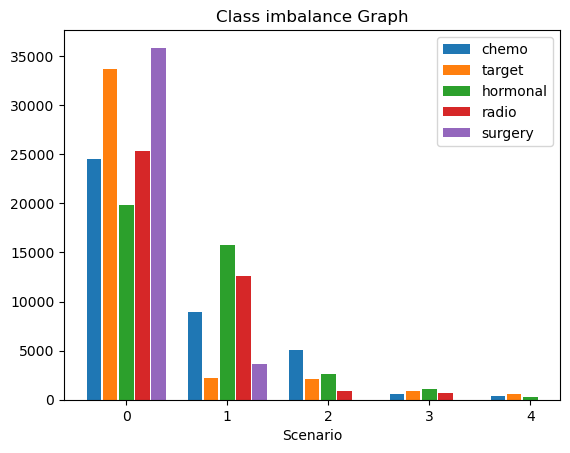

In [90]:
from matplotlib import pyplot as plt


def bar_plot(ax, data, colors=None, total_width=0.8, single_width=1, legend=True):
    """Draws a bar plot with multiple bars per data point.

    Parameters
    ----------
    ax : matplotlib.pyplot.axis
        The axis we want to draw our plot on.

    data: dictionary
        A dictionary containing the data we want to plot. Keys are the names of the
        data, the items is a list of the values.

        Example:
        data = {
            "x":[1,2,3],
            "y":[1,2,3],
            "z":[1,2,3],
        }

    colors : array-like, optional
        A list of colors which are used for the bars. If None, the colors
        will be the standard matplotlib color cyle. (default: None)

    total_width : float, optional, default: 0.8
        The width of a bar group. 0.8 means that 80% of the x-axis is covered
        by bars and 20% will be spaces between the bars.

    single_width: float, optional, default: 1
        The relative width of a single bar within a group. 1 means the bars
        will touch eachother within a group, values less than 1 will make
        these bars thinner.

    legend: bool, optional, default: True
        If this is set to true, a legend will be added to the axis.
    """

    # Check if colors where provided, otherwhise use the default color cycle
    if colors is None:
        colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

    # Number of bars per group
    n_bars = len(data)

    # The width of a single bar
    bar_width = total_width / n_bars

    # List containing handles for the drawn bars, used for the legend
    bars = []

    # Iterate over all data
    for i, (name, values) in enumerate(data.items()):
        # The offset in x direction of that bar
        x_offset = (i - n_bars / 2) * bar_width + bar_width / 2

        # Draw a bar for every value of that type
        for x, y in enumerate(values):
            bar = ax.bar(x + x_offset, y, width=bar_width * single_width, color=colors[i % len(colors)])
        # Add a handle to the last drawn bar, which we'll need for the legend
        bars.append(bar[0])
    # Draw legend if we need
    if legend:
        ax.legend(bars, data.keys())
        ax.set_xlabel('Scenario')
        ax.set_title('Class imbalance Graph')


if __name__ == "__main__":
    # Usage example:
    data = { 
        "chemo": values[0][0],
         "target": values[0][1],
         "hormonal": values[0][2],
         "radio": values[0][3],
         "surgery": values[0][4],}

    fig, ax = plt.subplots()
    bar_plot(ax, data, total_width=.8, single_width=.9)
    plt.show()


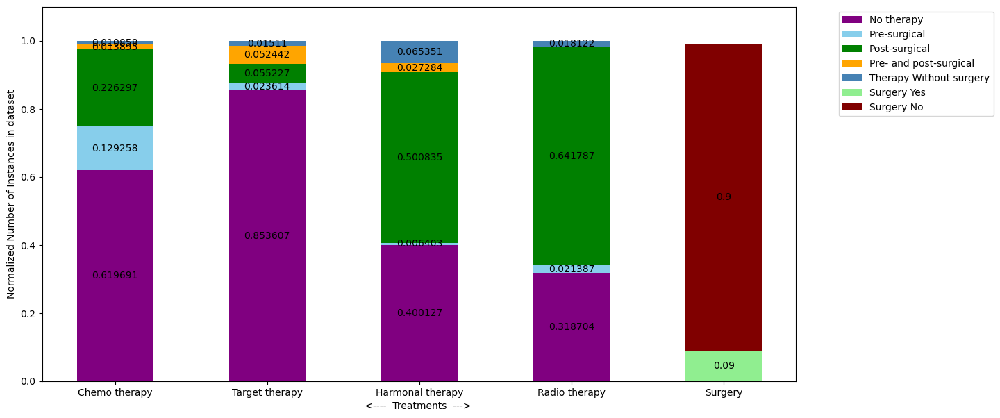

In [91]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Sample data based on the provided image
data = {
    'Treatment': ['Chemo therapy', 'Target therapy', 'Harmonal therapy', 'Radio therapy', 'Surgery'],
    'No therapy': [0.619691,0.853607,0.400127,0.318704,0],
    'Pre-surgical': [0.129258,0.023614,0.006403,0.021387,0],
    'Post-surgical': [0.226297,0.055227,0.500835,0.641787,0],
    'Pre- and post-surgical': [0.013895,0.052442,0.027284,0,0],
    'Therapy Without surgery': [0.010858,0.01511,0.065351,0.018122,0],
    
    
    
    'Surgery Yes': [0, 0, 0, 0, 0.09],
    'Surgery No': [0, 0, 0, 0, 0.9]
}

# Create DataFrame
df = pd.DataFrame(data)
df.set_index('Treatment', inplace=True)

# Plot
fig, ax = plt.subplots(figsize=(14, 7))

# Define colors
colors = ['purple', 'skyblue', 'green', 'orange', 'steelblue', 'lightgreen', 'maroon']

# Define bar width
bar_width = 0.5

# Stack the bars
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    ax.bar(df.index, df[col], bottom=bottom, color=colors[i], label=col, width=bar_width)
    bottom += df[col]

# Add labels
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    for j, value in enumerate(df[col]):
        if value > 0:
            ax.text(j, bottom[j] + value / 2, f"{value}", ha='center', va='center', fontsize=10)
    bottom += df[col]

# Customizing the plot
ax.set_xlabel(' <----  Treatments  --->  ')
ax.set_ylabel('Normalized Number of Instances in dataset')
#ax.set_title('Number of Instances by Treatment and Surgery Status')
ax.set_ylim(0, 1.1)

# Adjust legend position inside the plot
ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))

plt.xticks(rotation=0)
#plt.tight_layout(rect=[0, 0, 1, 1])  # Adjust layout to fit legend
plt.show()


In [92]:
# Reset the index calues as Train_test split randomly choose the data points, hance the index values are random 
x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
y_train


,chemo,target,hormonal,radio,surgery
0,0,3,2,2,0
1,1,0,2,0,0
2,0,0,0,2,1
3,0,0,2,4,0
4,0,0,0,2,0
...,...,...,...,...,...
31603,0,0,4,2,1
31604,2,0,4,2,1
31605,0,0,2,2,0
31606,0,0,2,2,0


In [93]:
X.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39510 entries, 0 to 39509
Data columns (total 46 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Age_at_incidence_date      39510 non-null  int64  
 1   Sex                        39510 non-null  int64  
 2   Tumor_type                 39510 non-null  int64  
 3   Basis_for_diagnosis        39510 non-null  int64  
 4   Lateralization             39510 non-null  float64
 5   Morphology                 39510 non-null  int64  
 6   cm_TNM                     39510 non-null  float64
 7   Er_status                  39510 non-null  float64
 8   Pr_status                  39510 non-null  float64
 9   HER2_state                 39510 non-null  float64
 10  DCIS_component             39510 non-null  float64
 11  Tumor_multifocality        39510 non-null  float64
 12  Topography_including_C501  39510 non-null  bool   
 13  Topography_including_C502  39510 non-null  boo

# Method 1: Cost sensitive learning

assigning a high cost to misclassification of the minority class, and trying to minimize the overall cost

In [94]:
Y.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39510 entries, 0 to 39509
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   chemo     39510 non-null  int64
 1   target    39510 non-null  int64
 2   hormonal  39510 non-null  int64
 3   radio     39510 non-null  int64
 4   surgery   39510 non-null  int64
dtypes: int64(5)
memory usage: 1.5 MB


In [95]:
from sklearn.utils.class_weight import compute_class_weight
Xx = DATA.loc[:, ~DATA.columns.isin(['chemo', 'target', 'hormonal', 'radio', 'surgery'])].values
Yy = DATA[['chemo', 'target', 'hormonal', 'radio', 'surgery']].values

# Calculate class weights for each output column
class_weights = []
for i in range(Yy.shape[1]):
    unique_classes = np.unique(Yy[:, i])
    class_weight = compute_class_weight(class_weight='balanced', classes=unique_classes, y=Yy[:, i])
    class_weights.append(dict(enumerate(class_weight)))


In [96]:
class_weights

[{0: 0.3227413821271034,
  1: 1.5472880360289798,
  2: 0.8837937590873504,
  3: 14.39344262295082,
  4: 18.41958041958042},
 {0: 0.23429994662871376,
  1: 8.469453376205788,
  2: 3.621448212648946,
  3: 3.813706563706564,
  4: 13.236180904522612},
 {0: 0.4998418622303751,
  1: 31.233201581027668,
  2: 0.39933292904790785,
  3: 7.330241187384044,
  4: 3.0604182804027884},
 {0: 0.7844266200762389,
  1: 11.689349112426035,
  2: 0.38953740584454,
  3: 13.795391061452515},
 {0: 0.5509999163249937, 1: 5.401968826907301}]

In [97]:
### for imbalance datasets:

forest = RandomForestClassifier(random_state=1, class_weight=class_weights)
predicted_values= multi_target_forest.fit(x_train,y_train).predict(x_test)

In [98]:
predicted_values

array([[0, 0, 0, 2, 0],
       [0, 0, 2, 2, 0],
       [0, 0, 0, 0, 0],
       ...,
       [0, 0, 0, 2, 0],
       [0, 0, 2, 2, 0],
       [2, 3, 2, 0, 0]])

In [99]:
y_test

,chemo,target,hormonal,radio,surgery
0,0,0,0,2,0
1,2,0,0,2,0
2,0,0,2,2,0
3,2,0,0,0,0
4,0,0,0,2,0
...,...,...,...,...,...
7897,2,0,2,2,0
7898,0,0,2,2,0
7899,0,0,0,2,0
7900,0,0,3,2,0


In [100]:
from sklearn.metrics import accuracy_score, f1_score, log_loss
from sklearn.metrics import precision_score, recall_score, f1_score

accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
y_test.reset_index(drop=True, inplace=True)

for i in range(Y.shape[1]):
    
    # Calculate Accuracy separately for each labal
    y_pred=[predicted_values[j][i]for j in range(len(x_test))] #First column of each row contains the prediction values of first class("chemo" in this case) and so on...
    y_true=[y_test[y_test.columns[i]][j]for j in range (len(y_test))] # Y[Y.columns[i]][j]= Y['chemo'][0]--> Y.columns[i]= 'chemo','target',...
    accuracy = accuracy_score(y_pred, y_true) #accuracy of each class.
    accuracies.append(accuracy)
    
    # Calculate F1 score separately for each labal
    f1 = f1_score(y_true, y_pred, average='weighted')  # Use average='binary' for each output
    f1_scores.append(f1)
    
    precision = precision_score(y_true, y_pred, average='weighted')
    recall = recall_score(y_true, y_pred,average='weighted')
    precisions.append(precision)
    recalls.append(recall)
    

# Compute average accuracy across all outputs
average_accuracy = sum(accuracies) / len(accuracies)
average_precision = sum(precisions) / len(precisions)
average_recall = sum(recalls) / len(recalls)

# Compute average F1 score across all outputs
average_f1_score = sum(f1_scores) / len(f1_scores)

#print("Accuracy Score for Multiclass-Multioutput:", accuracies )
#print("F1 Score for Multiclass-Multioutput:", f1_scores)
#print("Precision:", precisions)
#print("Recall:", recalls)

In [101]:
print("............................................................................................................")
print('                   Acuracy               ', 'f1_scores               ' , 'Precision                 ', 'Recall        ')
print("............................................................................................................")
for i in range (len(accuracies)):
    print(" ")
    print(y_test.columns[i], '     ',accuracies[i],'    ', f1_scores[i],'    ' , precisions[i],'     ', recalls[i],' ')
    
print("............................................................................................................")

............................................................................................................
                   Acuracy                f1_scores                Precision                  Recall        
............................................................................................................
 
chemo       0.5248038471273095      0.4787280974297596      0.4526971321640997       0.5248038471273095  
 
target       0.8027081751455328      0.7633458167077258      0.7290441310663197       0.8027081751455328  
 
hormonal       0.4805112629713996      0.4695716779695867      0.4621247896920615       0.4805112629713996  
 
radio       0.5664388762338648      0.5374199728390779      0.5203313053636465       0.5664388762338648  
 
surgery       0.8762338648443432      0.8496886506325121      0.8263014561951089       0.8762338648443432  
............................................................................................................


In [102]:
y= Y['chemo']

# Method 2: sampling technique

Either down-sampling the majority class or over-sampling the minority class, or both. There are chances to lose the information in down-sampling of the majority class. 



#checking accuracy, F1_score , precision, and recall for a single calss ['chemo'], Leter will apply this technique to all classes


In [103]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE

Xx = DATA.loc[:, ~DATA.columns.isin(['chemo','target','hormonal','radio','surgery'])]
Yy = DATA['chemo']
smote = SMOTE(random_state=42)
X_class_resampled, y_class_resampled = smote.fit_resample(Xx , Yy)

print('Origianl dataset shape:', Counter(Yy))
print('Resampple dataset shape:', Counter(y_class_resampled))

x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

#X_res, y_res = sm.fit_resample(x_train, y_train)


rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)



Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})


In [104]:
print(f"Accuracy {accuracy_score(y_test, y_pred)}")
print(f"F1 Score {f1_score(y_test, y_pred, average='macro')}")
print(f"Recall {recall_score(y_test, y_pred,average='weighted')}")
print(f"Precision {precision_score(y_test, y_pred, average='weighted')}")


Accuracy 0.798235582421173
F1 Score 0.7961914077988881
Recall 0.798235582421173
Precision 0.8003258996478335


In [105]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 


for i in Y:
    y=Y[i]
    smote = SMOTE(random_state=42)
    
    X_class_resampled, y_class_resampled = smote.fit_resample(X , y)
    
    X_class_resampled.replace({False: 0, True: 1}, inplace=True)
    y_class_resampled.replace({False:0, True:1}, inplace= True)
    
    print('Values for', i)
    print('Origianl dataset shape:', Counter(y))
    print('Resampple dataset shape:', Counter(y_class_resampled))

    x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

    x_train.reset_index(drop=True, inplace=True)
    y_train.reset_index(drop=True, inplace=True)
    x_test.reset_index(drop=True, inplace=True)
    y_test.reset_index(drop=True, inplace=True)

    #X_res, y_res = sm.fit_resample(x_train, y_train)


    rf = RandomForestClassifier()
    rf.fit(x_train, y_train)
    y_pred = rf.predict(x_test)

    
    accuracy = accuracy_score(y_test, y_pred) #accuracy of each class.
    accuracies.append(accuracy)
    
    # Calculate F1 score separately for each labal
    f1 = f1_score(y_test, y_pred, average='weighted')  # Use average='binary' for each output
    f1_scores.append(f1)
    precision = precision_score(y_test, y_pred, average='weighted')
    precisions.append(precision)
    recall = recall_score(y_test, y_pred,average='weighted')
    recalls.append(recall)
    
print("............................................................................................................")
print('                   Acuracy               ', 'f1_scores               ' , 'Precision                 ', 'Recall        ')
print("............................................................................................................")
for i in range (len(accuracies)):
    print(" ")
    print(Y.columns[i], '     ',accuracies[i],'    ', f1_scores[i],'    ' , precisions[i],'     ', recalls[i],' ')
    
print("............................................................................................................")


Values for chemo
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Values for target
Origianl dataset shape: Counter({0: 33726, 2: 2182, 3: 2072, 1: 933, 4: 597})
Resampple dataset shape: Counter({4: 33726, 0: 33726, 2: 33726, 3: 33726, 1: 33726})
Values for hormonal
Origianl dataset shape: Counter({2: 19788, 0: 15809, 4: 2582, 3: 1078, 1: 253})
Resampple dataset shape: Counter({0: 19788, 2: 19788, 4: 19788, 1: 19788, 3: 19788})
Values for radio
Origianl dataset shape: Counter({2: 25357, 0: 12592, 1: 845, 4: 716})
Resampple dataset shape: Counter({0: 25357, 2: 25357, 4: 25357, 1: 25357})
Values for surgery
Origianl dataset shape: Counter({0: 35853, 1: 3657})
Resampple dataset shape: Counter({0: 35853, 1: 35853})
............................................................................................................
                   Acuracy                f1_scores     

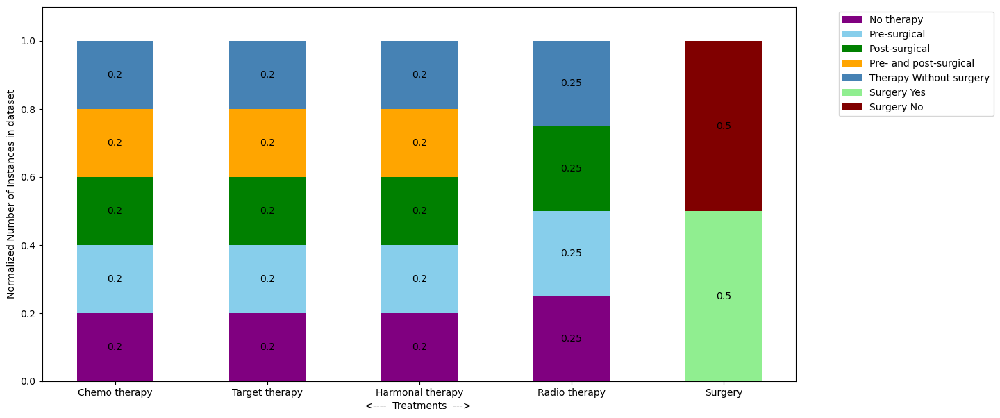

In [106]:
# Class Balance Graph

# Sample data based on the provided image
data = {
    'Treatment': ['Chemo therapy', 'Target therapy', 'Harmonal therapy', 'Radio therapy', 'Surgery'],
    'No therapy': [0.2,0.2,0.2,0.25,0],
    'Pre-surgical': [0.2,0.2,0.2,0.25,0],
    'Post-surgical': [0.2,0.2,0.2,0.25,0],
    'Pre- and post-surgical': [0.2,0.2,0.2,0,0],
    'Therapy Without surgery': [0.2,0.2,0.2,0.25,0],
    
    
    
    'Surgery Yes': [0, 0, 0, 0, 0.5],
    'Surgery No': [0, 0, 0, 0, 0.5]
}

# Create DataFrame
df = pd.DataFrame(data)
df.set_index('Treatment', inplace=True)

# Plot
fig, ax = plt.subplots(figsize=(14, 7))

# Define colors
colors = ['purple', 'skyblue', 'green', 'orange', 'steelblue', 'lightgreen', 'maroon']

# Define bar width
bar_width = 0.5

# Stack the bars
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    ax.bar(df.index, df[col], bottom=bottom, color=colors[i], label=col, width=bar_width)
    bottom += df[col]

# Add labels
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    for j, value in enumerate(df[col]):
        if value > 0:
            ax.text(j, bottom[j] + value / 2, f"{value}", ha='center', va='center', fontsize=10)
    bottom += df[col]

# Customizing the plot
ax.set_xlabel(' <----  Treatments  --->  ')
ax.set_ylabel('Normalized Number of Instances in dataset')
#ax.set_title('Number of Instances by Treatment and Surgery Status')
ax.set_ylim(0, 1.1)

# Adjust legend position inside the plot
ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))

plt.xticks(rotation=0)
#plt.tight_layout(rect=[0, 0, 1, 1])  # Adjust layout to fit legend
plt.show()


# Kernal Shap and Lime Explainer for individual prediction
### Shap Explainer single instance 
### Lime for single instance

In [107]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['chemo_0','chemo_presurgical only','chemo_post-surgical only','chemo_pre and post surgical','chemo_Yes, no surgery'],
        'target':['target_0','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['hormonal_0','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['radio_0','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['No_surgery','surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}


y=Y['chemo']
smote = SMOTE(random_state=42)

X_class_resampled, y_class_resampled = smote.fit_resample(X , y)

X_class_resampled.replace({False: 0, True: 1}, inplace=True)
y_class_resampled.replace({False:0, True:1}, inplace= True)


print('Origianl dataset shape:', Counter(y))
print('Resampple dataset shape:', Counter(y_class_resampled))

x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

#X_res, y_res = sm.fit_resample(x_train, y_train)

#Randomforest Classifier
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)


Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})


In [108]:
# Choose a sample to explain
j = 5
sample = x_test.iloc[[j], :]

Predicted_class= rf.predict(sample)[0]
print(f'Actual class: {y_test[j]}')
print(f'Predicted class: {rf.predict(sample)[0]}')
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[j], :])[0]}')

Actual class: 1
Predicted class: 1
Prediction for 1st sample in X_test: [0.01 0.88 0.07 0.02 0.02]


In [109]:
classes_names[y_test.name]

['chemo_0',
 'chemo_presurgical only',
 'chemo_post-surgical only',
 'chemo_pre and post surgical',
 'chemo_Yes, no surgery']

### Shap Explainer single instance 

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/1 [00:00<?, ?it/s]

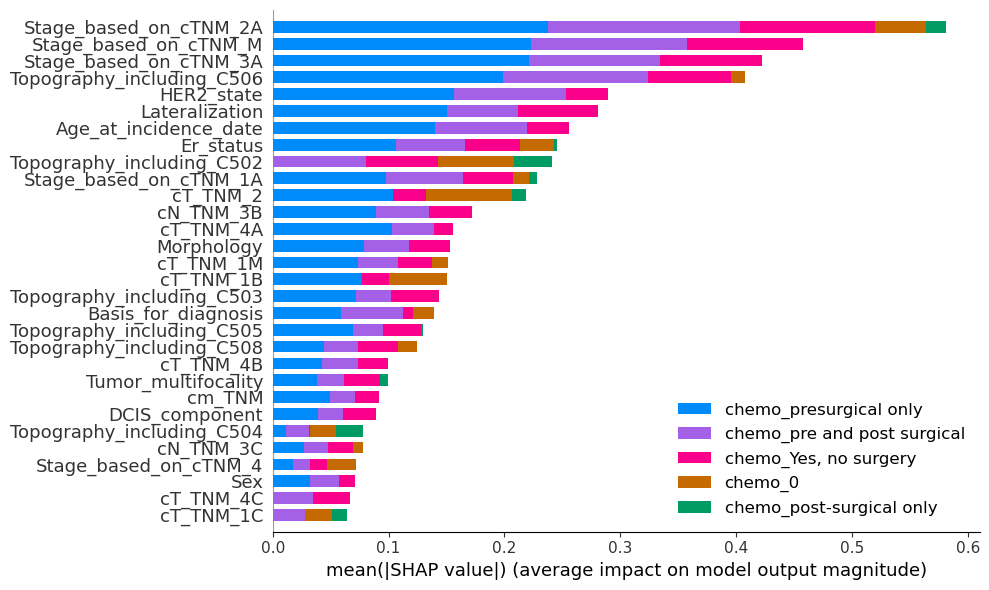

In [110]:
#Shap Explainer single instance 

# Define the number of samples to summarize the background data
K = 200  # Choose an appropriate value for K

# Summarize the background data using shap.sample()
background_sample = shap.sample(x_train, K)

# Use the summarized background sample in your SHAP model
explainer = shap.KernelExplainer(model=rf.predict_proba, data=background_sample)

#shap_values = explainer.shap_values(x_test.iloc[[1], :], nsamples=100)
shap_values = explainer.shap_values(sample, nsamples=100)


shap.summary_plot(shap_values, features=sample, feature_names=x_train.columns, class_names=classes_names[y_test.name], plot_type="bar", max_display=30,  plot_size=(10, 6), show=False)

plt.show()

   


predicted_class= 1


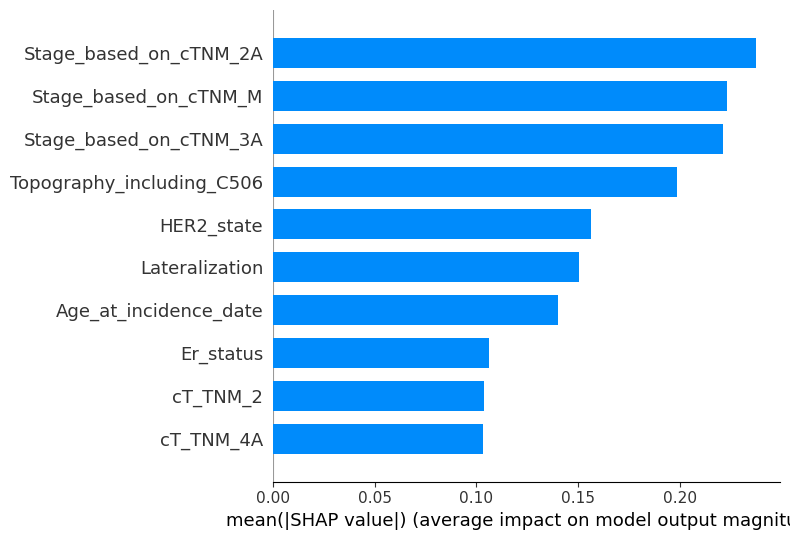

In [111]:


# for single label explanation    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

print('predicted_class=', Predicted_class)
shap.summary_plot(shap_values[1], feature_names=x_train.columns, class_names=classes_names[y_test.name], plot_type="bar", max_display=10, show=False)

plt.show()


predicted_class= 1


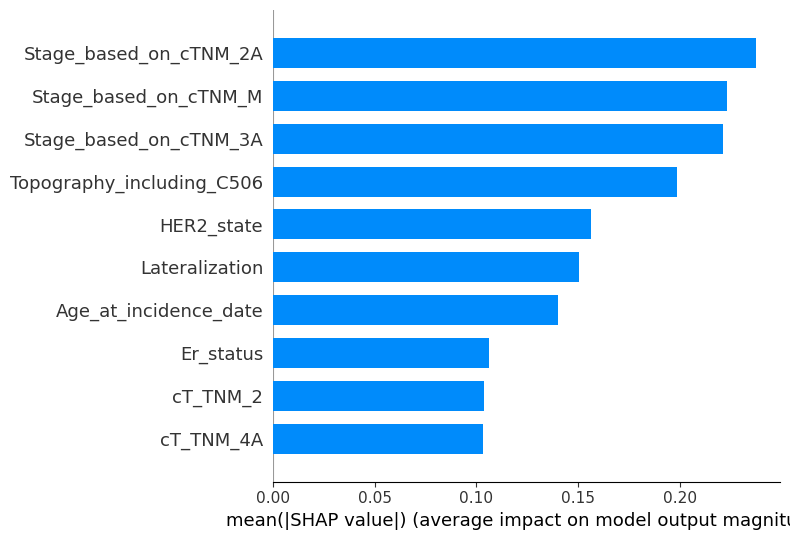

In [112]:
print('predicted_class=', Predicted_class)
shap.summary_plot(shap_values[Predicted_class], feature_names=x_train.columns, class_names=classes_names[y_test.name], plot_type="bar", max_display=10, show=False)

plt.show()

In [113]:
shap_values[1]

array([[-0.13999935,  0.03191818,  0.01190625,  0.0592261 ,  0.15022935,
         0.07900619,  0.04946873, -0.10602797,  0.        ,  0.15643762,
         0.0386817 , -0.0380874 , -0.02437546,  0.        , -0.07156534,
         0.01116017, -0.06923121,  0.19852404,  0.04399607, -0.00959783,
        -0.03549763,  0.02822888,  0.07693275,  0.        ,  0.07311196,
         0.10387206,  0.        , -0.10328821,  0.04239643,  0.        ,
        -0.03119992,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.08892031, -0.027009  , -0.0976741 , -0.23718252,
         0.        ,  0.22089861,  0.00230693,  0.        , -0.01754667,
         0.22323653]])

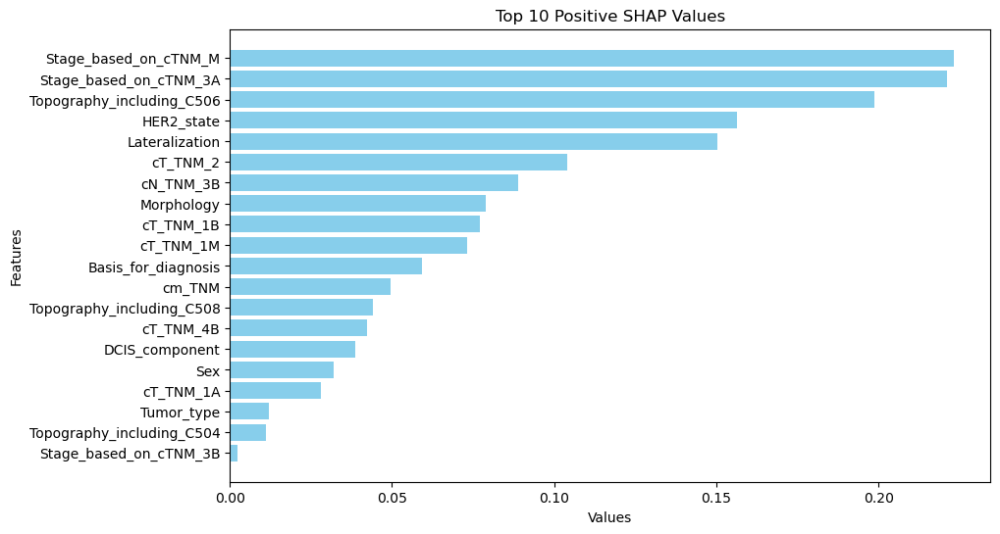

In [114]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names
shap_valuesss = shap_values[Predicted_class][0]
column_namesss = x_train.columns
# Flatten shap_values array
#shap_values = shap_values.flatten()

# Filter positive SHAP values
positive_shap_indices = np.where(shap_valuesss > 0)[0]
positive_shap_values = shap_valuesss[positive_shap_indices]
positive_shap_columns = np.array(column_namesss)[positive_shap_indices]

# Combine and sort by SHAP values
positive_shap_list = list(zip(positive_shap_columns, positive_shap_values))
positive_shap_list.sort(key=lambda x: x[1], reverse=True)

# Select top 20
top_10_shap = positive_shap_list[:25]

# Unzip to get column names and values
top_10_columns, top_10_values = zip(*top_10_shap)

# Plot the horizontal bar graph
plt.figure(figsize=(10, 6))
plt.barh(top_10_columns, top_10_values, color='skyblue')
plt.xlabel('Values')
plt.ylabel('Features')
plt.title('Top 10 Positive SHAP Values')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest value at the top
plt.show()


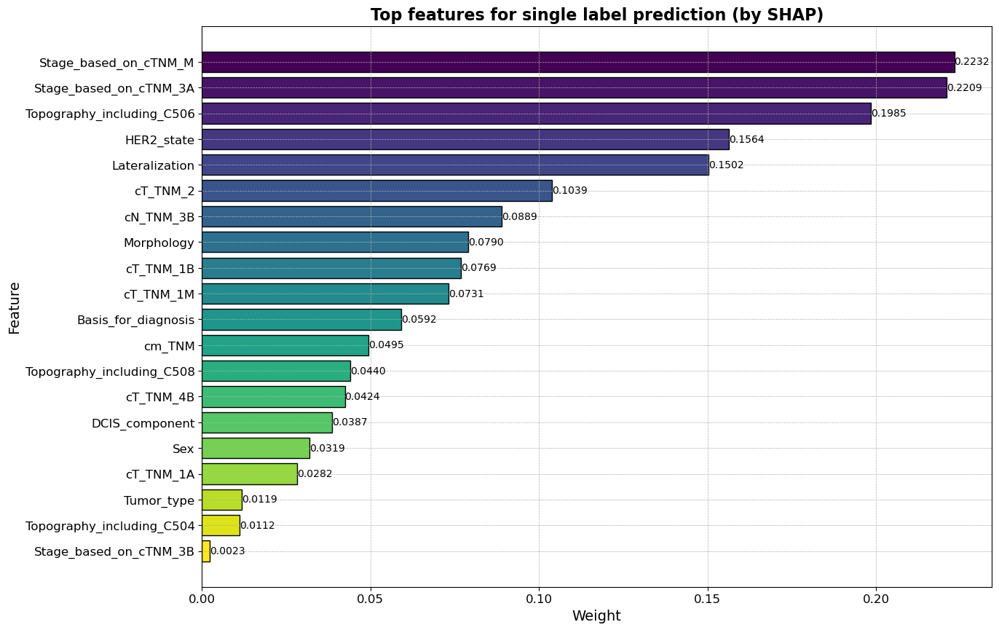

In [115]:

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(14, 10))
bars = ax.barh(top_10_columns, top_10_values, color=plt.cm.viridis(np.linspace(0, 1, len(top_10_values))), edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left', fontsize=10, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('Weight', fontsize=14)
ax.set_ylabel('Feature', fontsize=14)
ax.set_title('Top features for single label prediction (by SHAP)', fontsize=16, fontweight='bold')

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

plt.show()


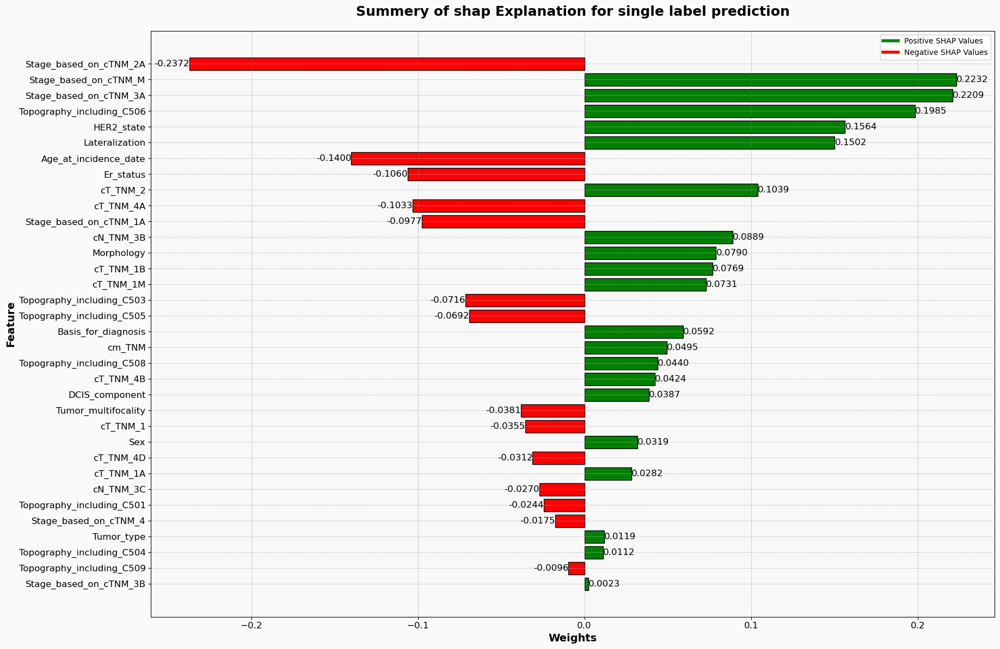

In [116]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names

shap_valuesss = shap_values[Predicted_class]
column_names = x_train.columns



# Flatten shap_valuesss array
shap_valuesss = shap_valuesss.flatten()

# Filter non-zero SHAP values
non_zero_indices = np.where(shap_valuesss != 0)[0]
non_zero_shap_values = shap_valuesss[non_zero_indices]
non_zero_shap_columns = np.array(column_names)[non_zero_indices]

# Sort by absolute values in descending order
sorted_indices = np.argsort(-np.abs(non_zero_shap_values))  # Note the negative sign to sort in descending order
sorted_shap_values = non_zero_shap_values[sorted_indices]
sorted_shap_columns = non_zero_shap_columns[sorted_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(20, 14), facecolor='#f7f7f7')

# Create a gradient background
ax.set_facecolor('#f7f7f7')
ax.patch.set_facecolor('#f7f7f7')
fig.patch.set_facecolor('#f7f7f7')

# Plot SHAP values
bars = ax.barh(sorted_shap_columns, sorted_shap_values, color=['green' if x > 0 else 'red' for x in sorted_shap_values], edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left' if bar.get_width() > 0 else 'right', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('Weights', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Summery of shap Explanation for single label prediction', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add legend
positive_patch = plt.Line2D([0], [0], color='green', lw=4, label='Positive SHAP Values')
negative_patch = plt.Line2D([0], [0], color='red', lw=4, label='Negative SHAP Values')
ax.legend(handles=[positive_patch, negative_patch])

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


### LIME Explainer single instance 

In [117]:

#LIME explainer single instance for same sample used for shap
# Choose a sample to explain

sample = x_test.iloc[[j], :]

explainer = LimeTabularExplainer(x_train.values, 
                             feature_names=x_train.columns, 
                             class_names=classes_names[y_test.name], 
                             discretize_continuous=True)

sample =sample.values.reshape(1, -1) #reshape the sample and pickup the value only (making it suitble for lime function)
print(f'Actual class: {y_test[j]}')
print(f'Predicted class: {rf.predict(sample)[0]}')

# Explain the prediction for the chosen sample
explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=46, top_labels=20)


# Visualize the explanation
#explanation.show_in_notebook(show_table=True, show_all=False)
    

    

Actual class: 1
Predicted class: 1


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


In [118]:
sample

array([[7.400e+01, 2.000e+00, 5.013e+05, 5.000e+00, 2.000e+00, 8.500e+03,
        0.000e+00, 1.000e+00, 1.000e+00, 3.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00]])

In [119]:
explanation.available_labels()


[1, 2, 4, 3, 0]

In [120]:
explanation.show_in_notebook(show_table=True, show_all=True)

In [121]:
explanation.local_exp

{0: [(38, -0.023722660553119758),
  (10, 0.02198794294151606),
  (11, -0.019834584415720783),
  (8, -0.01760434076323554),
  (4, -0.017386786930024052),
  (7, -0.011963454461500012),
  (15, 0.011331510361281443),
  (23, 0.01088756968035034),
  (25, -0.009823557939579605),
  (9, 0.009497927552959484),
  (30, -0.008585843926134892),
  (5, -0.008527776796461084),
  (43, -0.008511454501858766),
  (18, 0.00791500637585587),
  (28, -0.007831753011910957),
  (24, 0.007044231254574151),
  (27, -0.006158947964987392),
  (2, -0.006049635897614845),
  (22, -0.005919986972641459),
  (31, -0.0057965677806847),
  (39, -0.005687839092143507),
  (40, 0.005335320943503887),
  (29, -0.00522553844356262),
  (33, -0.004575025172276352),
  (14, 0.0037227131520187733),
  (19, -0.0034053219728645214),
  (13, -0.0033844870034808027),
  (32, -0.003248699053573509),
  (37, 0.003175063152104431),
  (20, -0.002758800844067619),
  (12, 0.0026991273942682226),
  (16, 0.0023639498715602616),
  (0, 0.0023209119484493

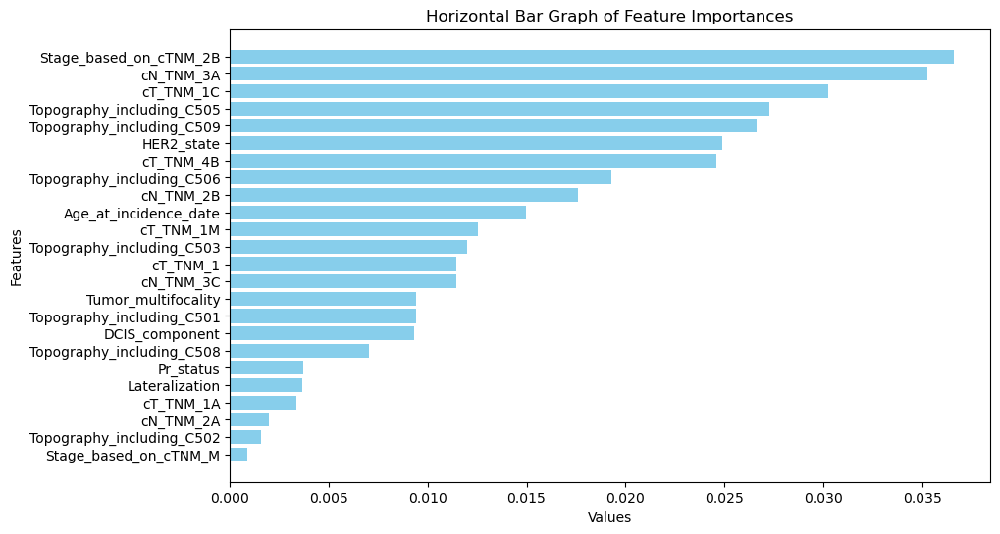

In [122]:
lime_values_of_Prid_cls= explanation.local_exp[Predicted_class]
positive_list = [(x, y) for x, y in lime_values_of_Prid_cls if y > 0]
# Separate the x and y values
x_values = [x for x, y in positive_list]
x_names = [column_names[t] for t in x_values]
y_values = [y for x, y in positive_list]

# Combine x_names and y_values into a list of tuples and sort by y_values
sorted_list = sorted(zip(x_names, y_values), key=lambda pair: pair[1])

# Unzip the sorted list
x_names_sorted, y_values_sorted = zip(*sorted_list)

# Create the horizontal bar plot
plt.figure(figsize=(10, 6))
plt.barh(x_names_sorted, y_values_sorted, color='skyblue')
plt.xlabel('Values')
plt.ylabel('Features')
plt.title('Horizontal Bar Graph of Feature Importances')
plt.show()

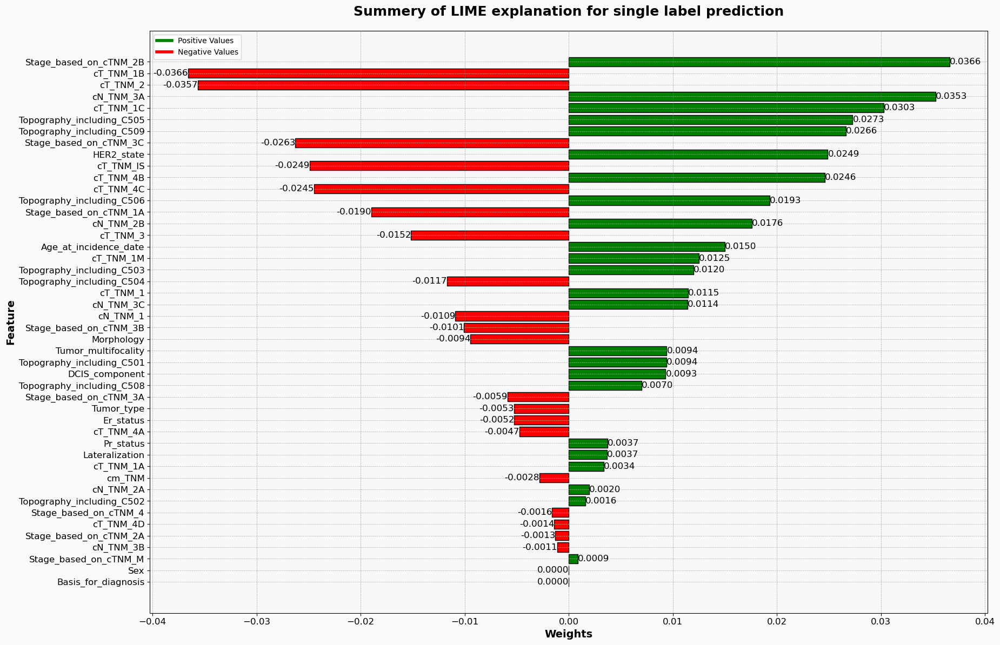

In [123]:
import matplotlib.pyplot as plt
import numpy as np

# Provided LIME values and column names
lime_values_of_Prid_cls = explanation.local_exp[Predicted_class]


column_names = x_train.columns

# Extract indices and values from lime_values_of_Prid_cls
indices = [idx for idx, val in lime_values_of_Prid_cls]
values = [val for idx, val in lime_values_of_Prid_cls]

# Get the corresponding column names
features = [column_names[idx] for idx in indices]

# Sort by absolute values in descending order
sorted_indices = np.argsort(-np.abs(values))
sorted_features = [features[i] for i in sorted_indices]
sorted_values = [values[i] for i in sorted_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(20, 14), facecolor='#f7f7f7')

# Create a gradient background
ax.set_facecolor('#f7f7f7')
ax.patch.set_facecolor('#f7f7f7')
fig.patch.set_facecolor('#f7f7f7')

# Plot LIME values
bars = ax.barh(sorted_features, sorted_values, color=['green' if x > 0 else 'red' for x in sorted_values], edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left' if bar.get_width() > 0 else 'right', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('Weights', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Summery of LIME explanation for single label prediction', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add legend
positive_patch = plt.Line2D([0], [0], color='green', lw=4, label='Positive Values')
negative_patch = plt.Line2D([0], [0], color='red', lw=4, label='Negative Values')
ax.legend(handles=[positive_patch, negative_patch])

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


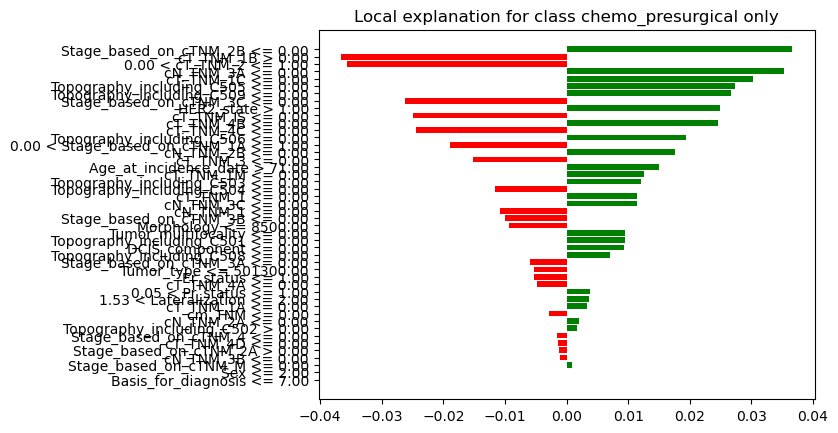

In [124]:
fig = explanation.as_pyplot_figure(label=Predicted_class)

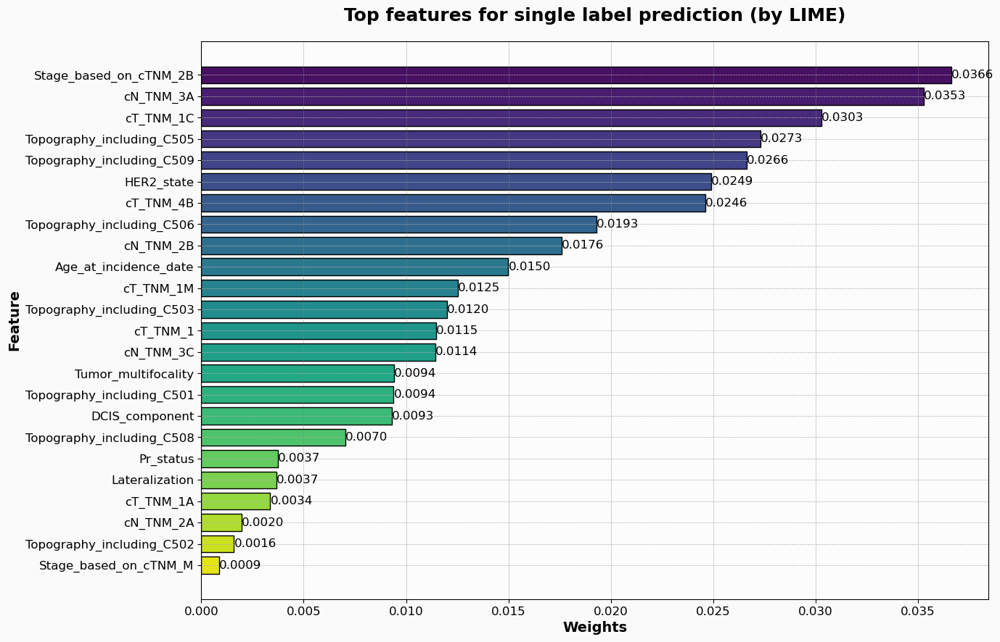

In [125]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Provided LIME values and column names
lime_values_of_Prid_cls = explanation.local_exp[Predicted_class]


column_names = x_train.columns


# Filter out only the positive values
positive_lime_values = [(idx, val) for idx, val in lime_values_of_Prid_cls if val > 0]

# Extract indices and values from positive_lime_values
indices = [idx for idx, val in positive_lime_values]
values = [val for idx, val in positive_lime_values]

# Get the corresponding column names
features = [column_names[idx] for idx in indices]

# Sort by values in descending order
sorted_indices = np.argsort(values)[::-1]
sorted_features = [features[i] for i in sorted_indices]
sorted_values = [values[i] for i in sorted_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(14, 10), facecolor='#f7f7f7')

# Set the color palette
colors = sns.color_palette("viridis", len(sorted_values))

# Plot positive LIME values with gradient colors
bars = ax.barh(sorted_features, sorted_values, color=colors, edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('Weights', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Top features for single label prediction (by LIME)', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


predicted_class= 1


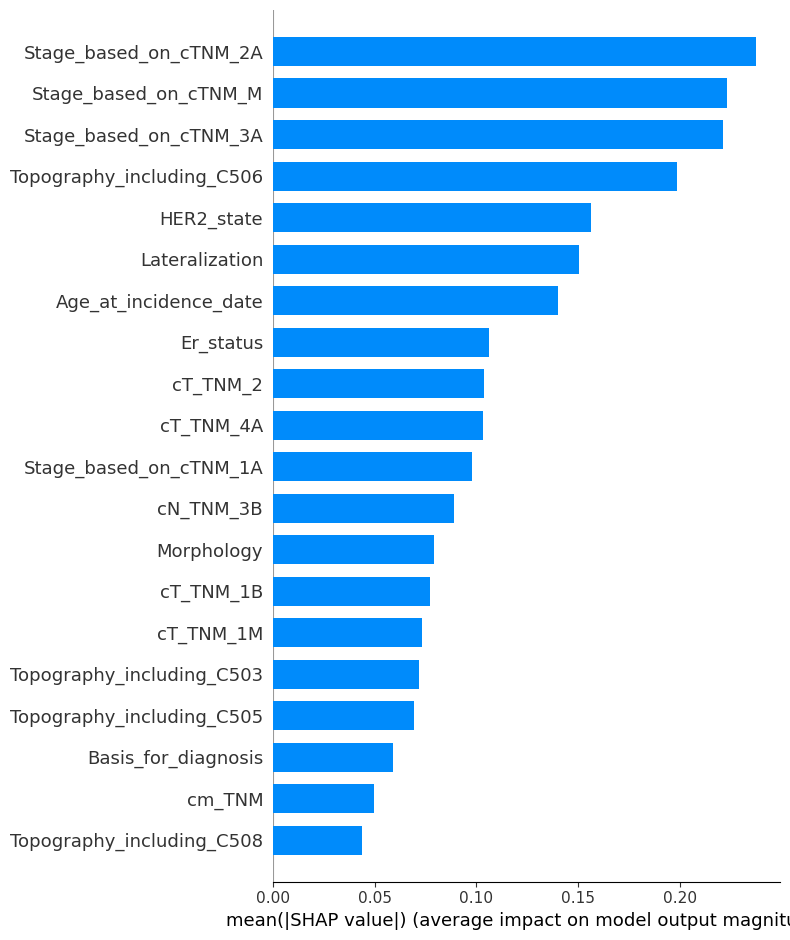

In [126]:
print('predicted_class=', Predicted_class)
shap.summary_plot(shap_values[Predicted_class], feature_names=x_train.columns, class_names=classes_names[y_test.name], plot_type="bar",max_display=20, show=False)

plt.show()

In [127]:
explanation.local_exp

{0: [(38, -0.023722660553119758),
  (10, 0.02198794294151606),
  (11, -0.019834584415720783),
  (8, -0.01760434076323554),
  (4, -0.017386786930024052),
  (7, -0.011963454461500012),
  (15, 0.011331510361281443),
  (23, 0.01088756968035034),
  (25, -0.009823557939579605),
  (9, 0.009497927552959484),
  (30, -0.008585843926134892),
  (5, -0.008527776796461084),
  (43, -0.008511454501858766),
  (18, 0.00791500637585587),
  (28, -0.007831753011910957),
  (24, 0.007044231254574151),
  (27, -0.006158947964987392),
  (2, -0.006049635897614845),
  (22, -0.005919986972641459),
  (31, -0.0057965677806847),
  (39, -0.005687839092143507),
  (40, 0.005335320943503887),
  (29, -0.00522553844356262),
  (33, -0.004575025172276352),
  (14, 0.0037227131520187733),
  (19, -0.0034053219728645214),
  (13, -0.0033844870034808027),
  (32, -0.003248699053573509),
  (37, 0.003175063152104431),
  (20, -0.002758800844067619),
  (12, 0.0026991273942682226),
  (16, 0.0023639498715602616),
  (0, 0.0023209119484493

In [130]:
explanation.local_pred

array([0.36211066])

In [131]:
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[j], :])[0]}')

Prediction for 1st sample in X_test: [0.01 0.88 0.07 0.02 0.02]


#  Lime and Tree shap Explainer for each class 


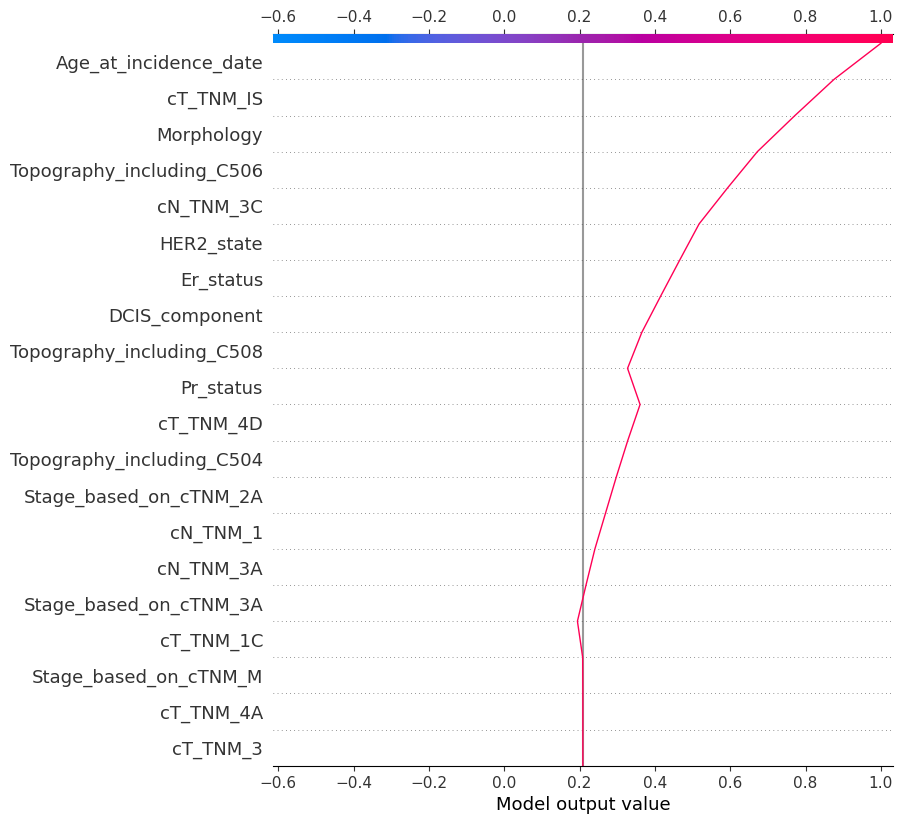

In [60]:
shap.decision_plot(explainer.expected_value[Predicted_class], shap_values[Predicted_class], x_test.columns)

'surgery'

Values for chemo
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Actual class: 3
Predicted class: 3


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


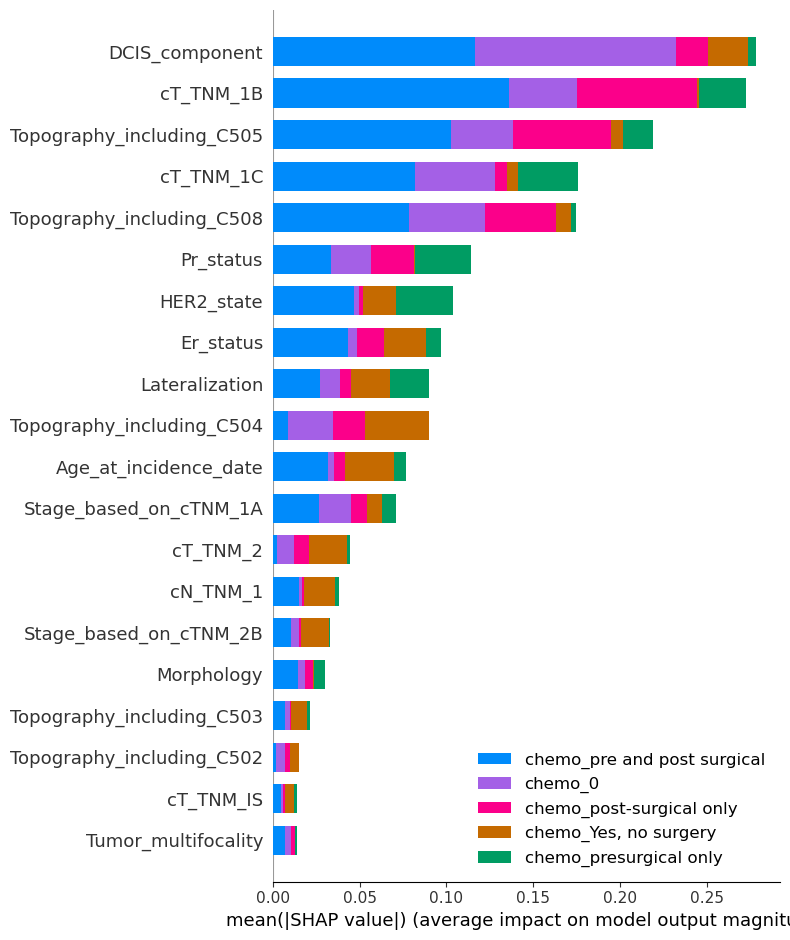

Values for target
Origianl dataset shape: Counter({0: 33726, 2: 2182, 3: 2072, 1: 933, 4: 597})
Resampple dataset shape: Counter({4: 33726, 0: 33726, 2: 33726, 3: 33726, 1: 33726})
Actual class: 1
Predicted class: 1


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


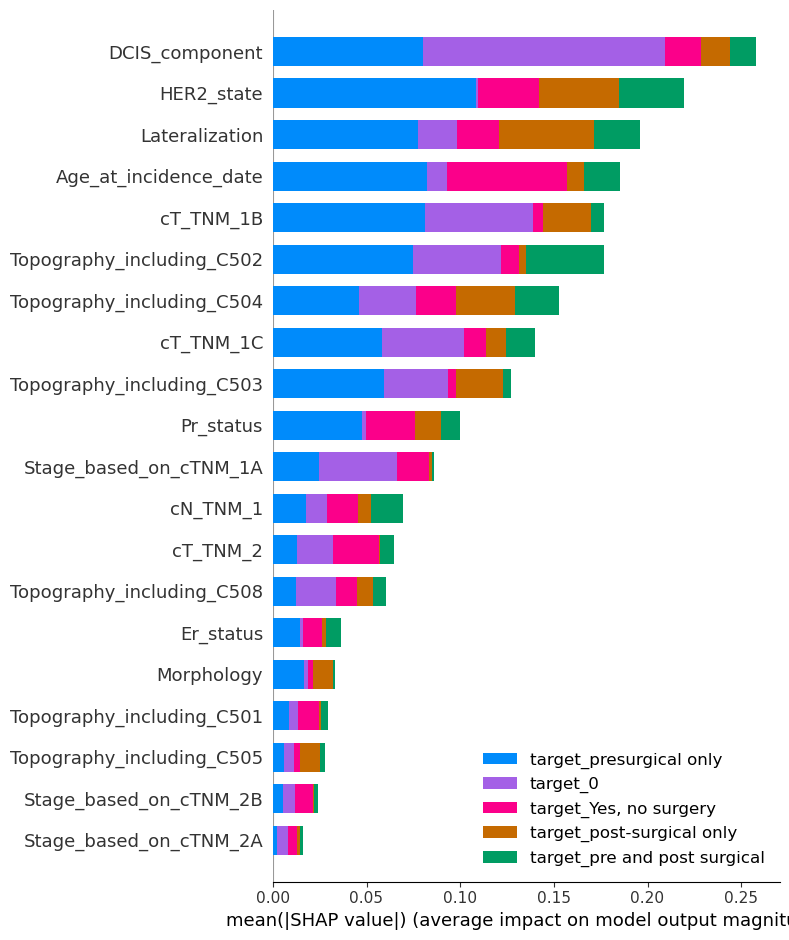

Values for hormonal
Origianl dataset shape: Counter({2: 19788, 0: 15809, 4: 2582, 3: 1078, 1: 253})
Resampple dataset shape: Counter({0: 19788, 2: 19788, 4: 19788, 1: 19788, 3: 19788})
Actual class: 4
Predicted class: 4


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


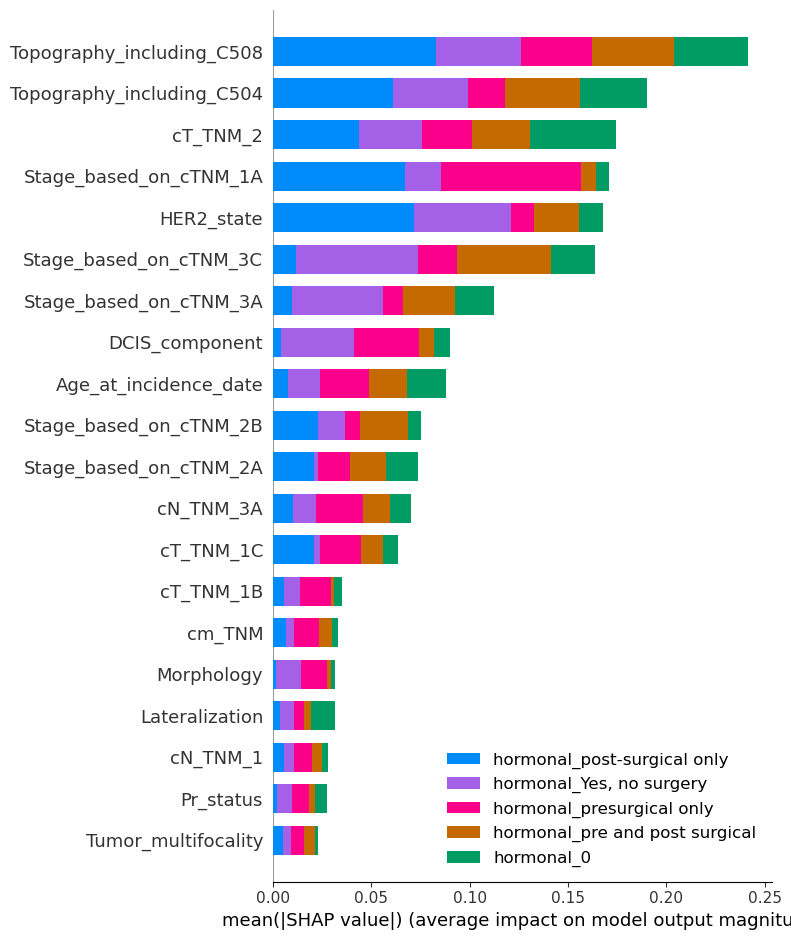

Values for radio
Origianl dataset shape: Counter({2: 25357, 0: 12592, 1: 845, 4: 716})
Resampple dataset shape: Counter({0: 25357, 2: 25357, 4: 25357, 1: 25357})
Actual class: 4
Predicted class: 4


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


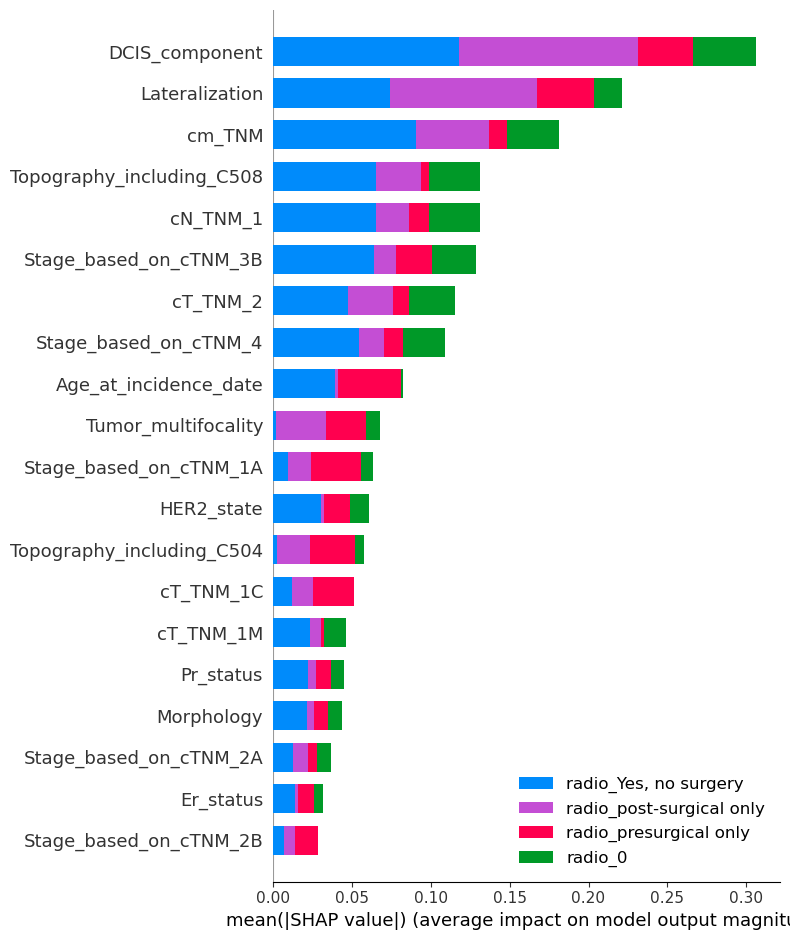

Values for surgery
Origianl dataset shape: Counter({0: 35853, 1: 3657})
Resampple dataset shape: Counter({0: 35853, 1: 35853})
Actual class: 0
Predicted class: 0


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


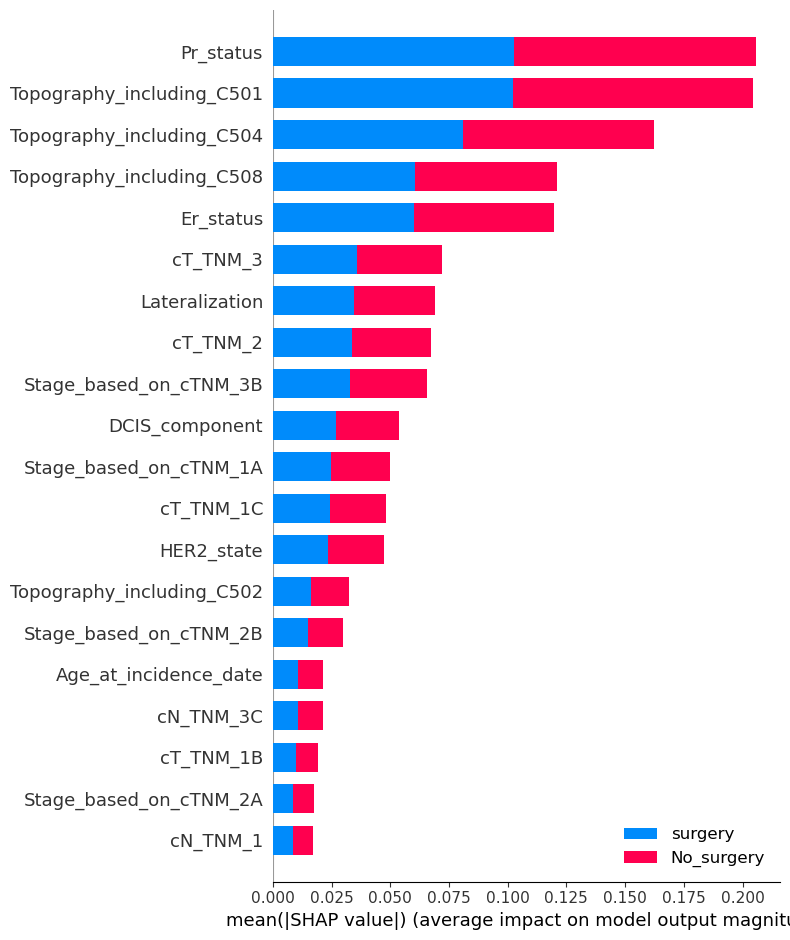

In [221]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['chemo_0','chemo_presurgical only','chemo_post-surgical only','chemo_pre and post surgical','chemo_Yes, no surgery'],
        'target':['target_0','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['hormonal_0','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['radio_0','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['No_surgery','surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}

for i in Y:
    y=Y[i]
    smote = SMOTE(random_state=42)
    
    X_class_resampled, y_class_resampled = smote.fit_resample(X , y)
    
    X_class_resampled.replace({False: 0, True: 1}, inplace=True)
    y_class_resampled.replace({False:0, True:1}, inplace= True)
    
    print('Values for', i)
    print('Origianl dataset shape:', Counter(y))
    print('Resampple dataset shape:', Counter(y_class_resampled))

    x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

    x_train.reset_index(drop=True, inplace=True)
    y_train.reset_index(drop=True, inplace=True)
    x_test.reset_index(drop=True, inplace=True)
    y_test.reset_index(drop=True, inplace=True)

    #X_res, y_res = sm.fit_resample(x_train, y_train)

    #Randomforest Classifier
    rf = RandomForestClassifier()
    rf.fit(x_train, y_train)
    y_pred = rf.predict(x_test)
    
    
    #LIME explainer single instance
    explainer = LimeTabularExplainer(x_train.values, 
                                 feature_names=x_train.columns, 
                                 class_names=classes_names[y_test.name], 
                                 discretize_continuous=True)

    # Choose a sample to explain
    j = 0
    sample = x_test.iloc[j].values.reshape(1, -1)
    print(f'Actual class: {y_test[j]}')
    print(f'Predicted class: {rf.predict(sample)[0]}')

    # Explain the prediction for the chosen sample
    explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=46, top_labels=10)


    # Visualize the explanation
    explanation.show_in_notebook(show_table=True, show_all=False)
    
    
    
    #Shap Explainer single instance 
    
    explainer = shap.TreeExplainer(rf)
    #explainer = shap.KernelExplainer(rf.predict,x_train)
    # Calculate shapley values for test data


    print('Shap Plot for same instance')
    # Choose a sample to explain

    shap_values = explainer.shap_values(sample)
    

    #shap.force_plot(explainer.expected_value[0],
    #                shap_values[1],
    #                sample) # for values


    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)
    
    plt.show()

    # Create a KernelExplainer





# Kernal Shap and Lime Explainer for individual prediction

Values for chemo
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Actual class: 0
Predicted class: 0
Prediction for 1st sample in X_test: [0.15 0.76 0.09 0.   0.  ]


  0%|          | 0/1 [00:00<?, ?it/s]

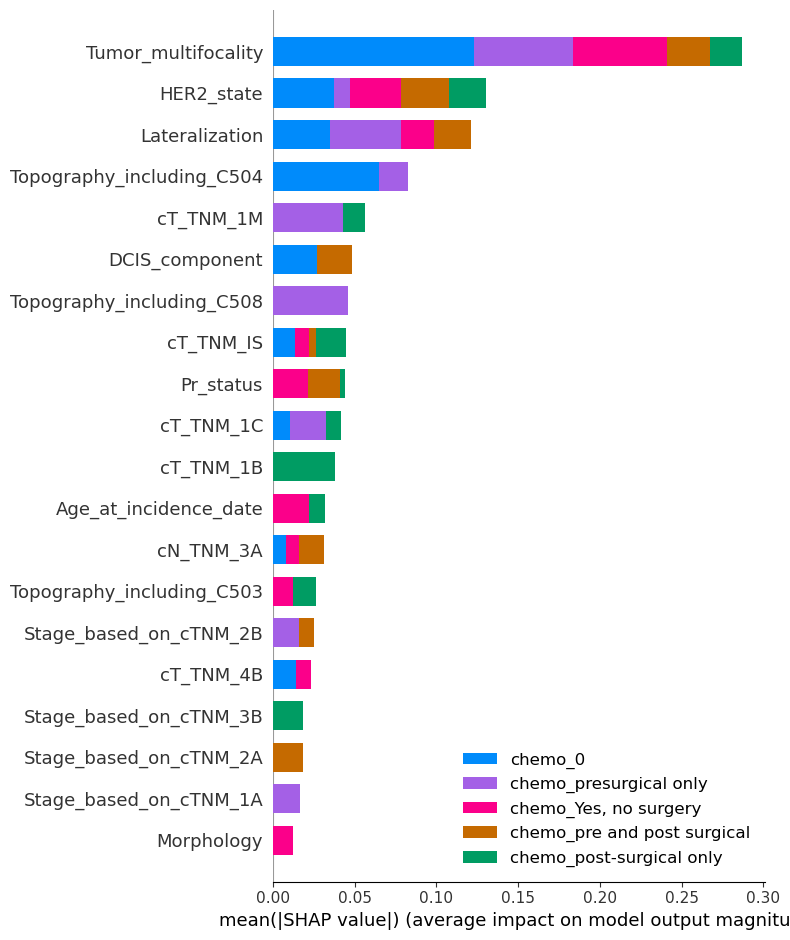

predicted_class= 0


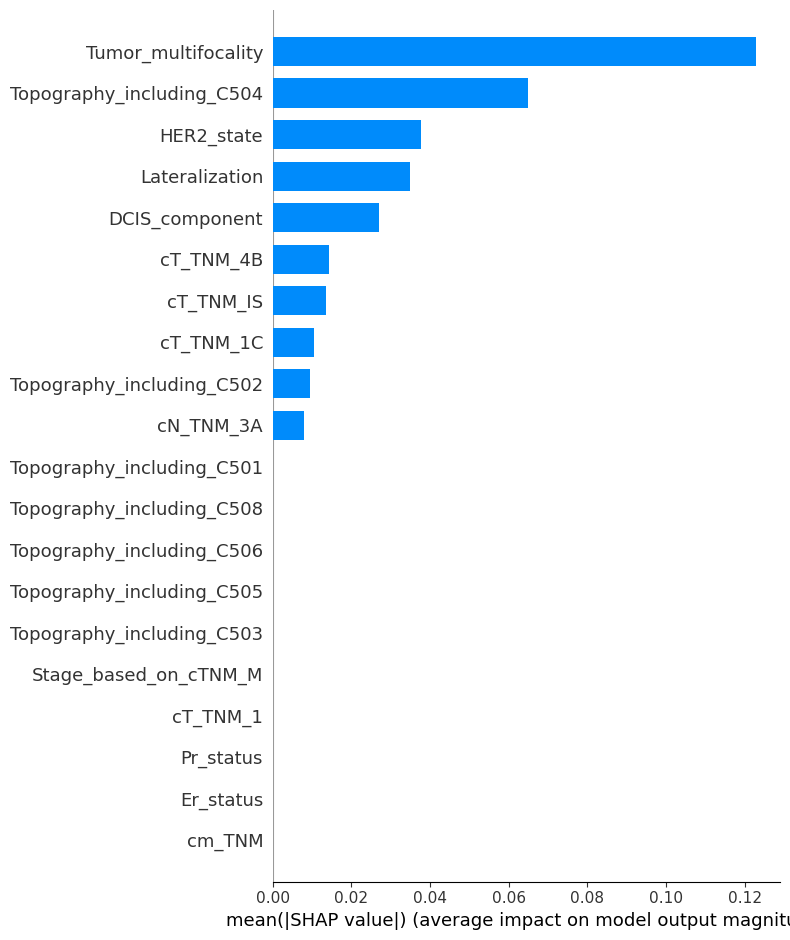

Values for target
Origianl dataset shape: Counter({0: 33726, 2: 2182, 3: 2072, 1: 933, 4: 597})
Resampple dataset shape: Counter({4: 33726, 0: 33726, 2: 33726, 3: 33726, 1: 33726})
Actual class: 1
Predicted class: 1
Prediction for 1st sample in X_test: [0.   0.   0.98 0.02 0.  ]


  0%|          | 0/1 [00:00<?, ?it/s]

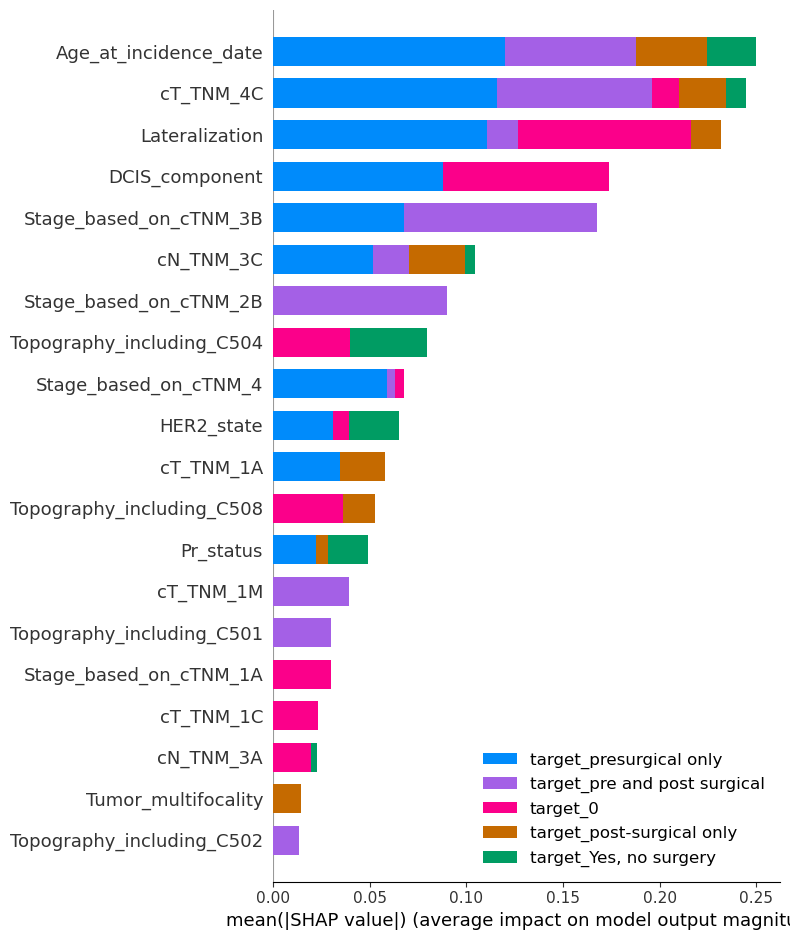

predicted_class= 1


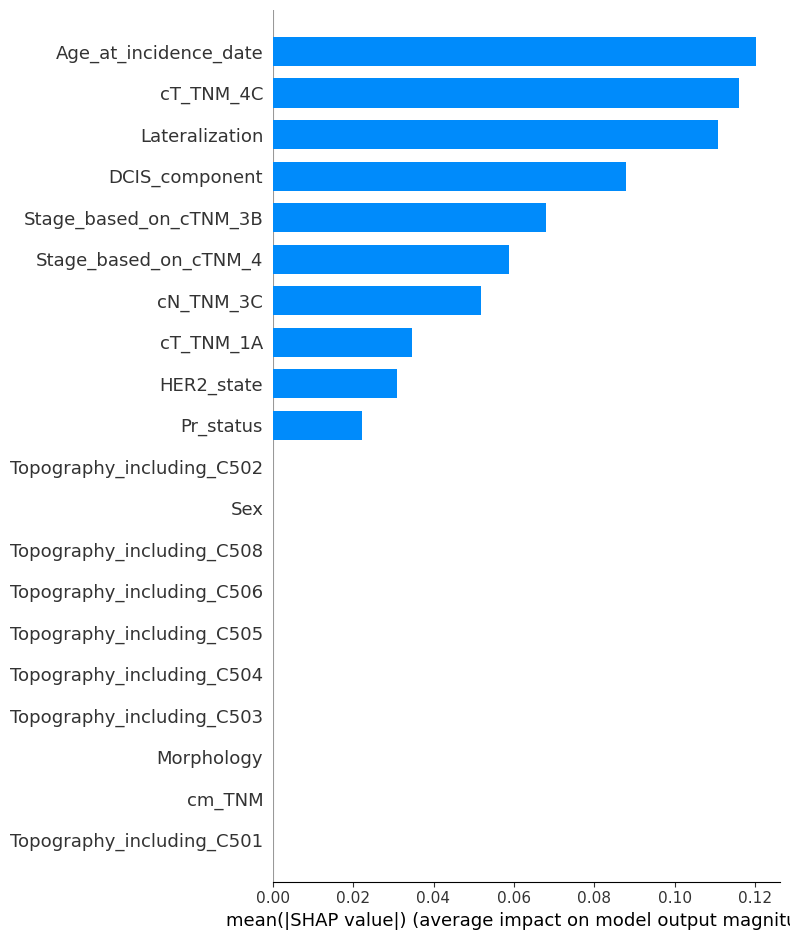

Values for hormonal
Origianl dataset shape: Counter({2: 19788, 0: 15809, 4: 2582, 3: 1078, 1: 253})
Resampple dataset shape: Counter({0: 19788, 2: 19788, 4: 19788, 1: 19788, 3: 19788})
Actual class: 4
Predicted class: 4
Prediction for 1st sample in X_test: [0.71 0.   0.29 0.   0.  ]


  0%|          | 0/1 [00:00<?, ?it/s]

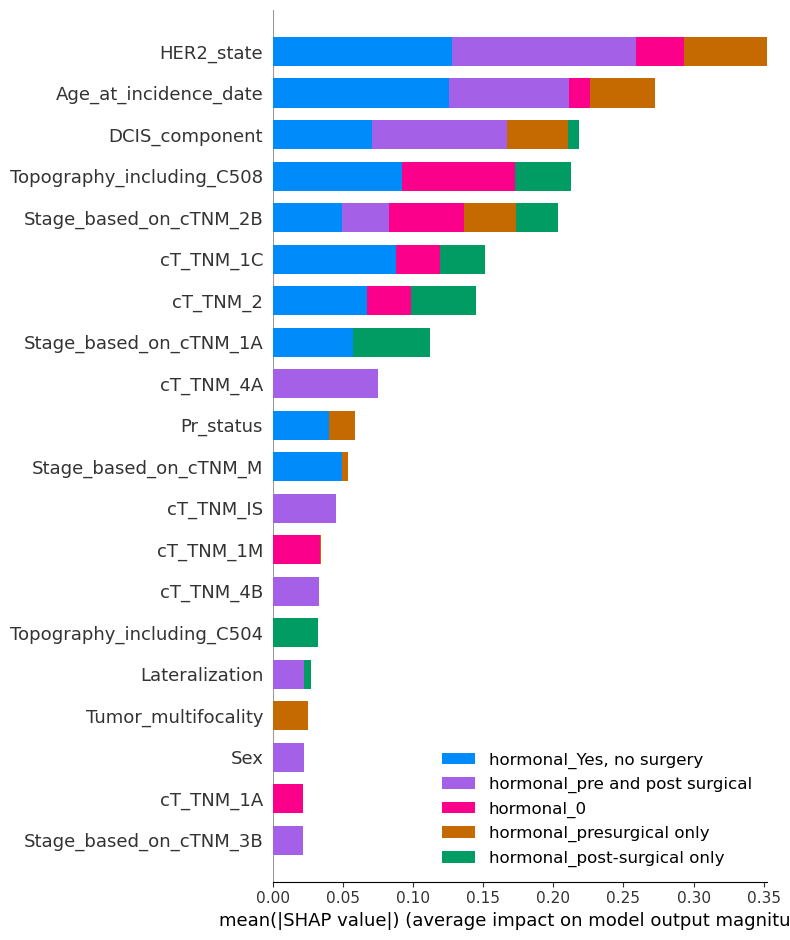

predicted_class= 4


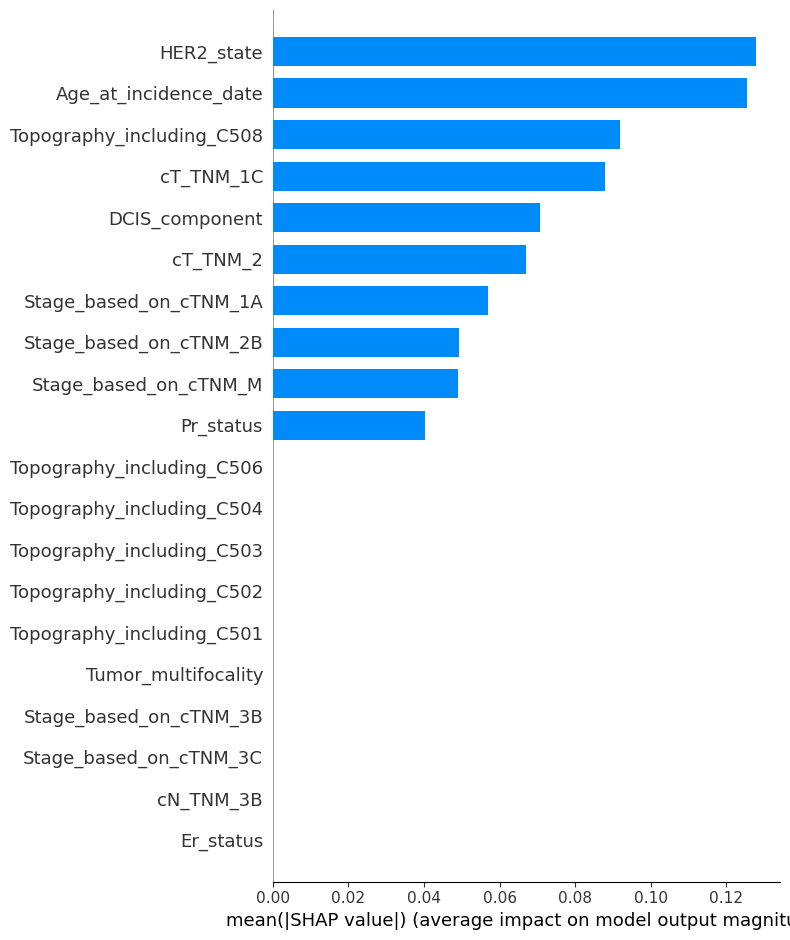

Values for radio
Origianl dataset shape: Counter({2: 25357, 0: 12592, 1: 845, 4: 716})
Resampple dataset shape: Counter({0: 25357, 2: 25357, 4: 25357, 1: 25357})
Actual class: 2
Predicted class: 2
Prediction for 1st sample in X_test: [0.01 0.01 0.   0.98]


  0%|          | 0/1 [00:00<?, ?it/s]

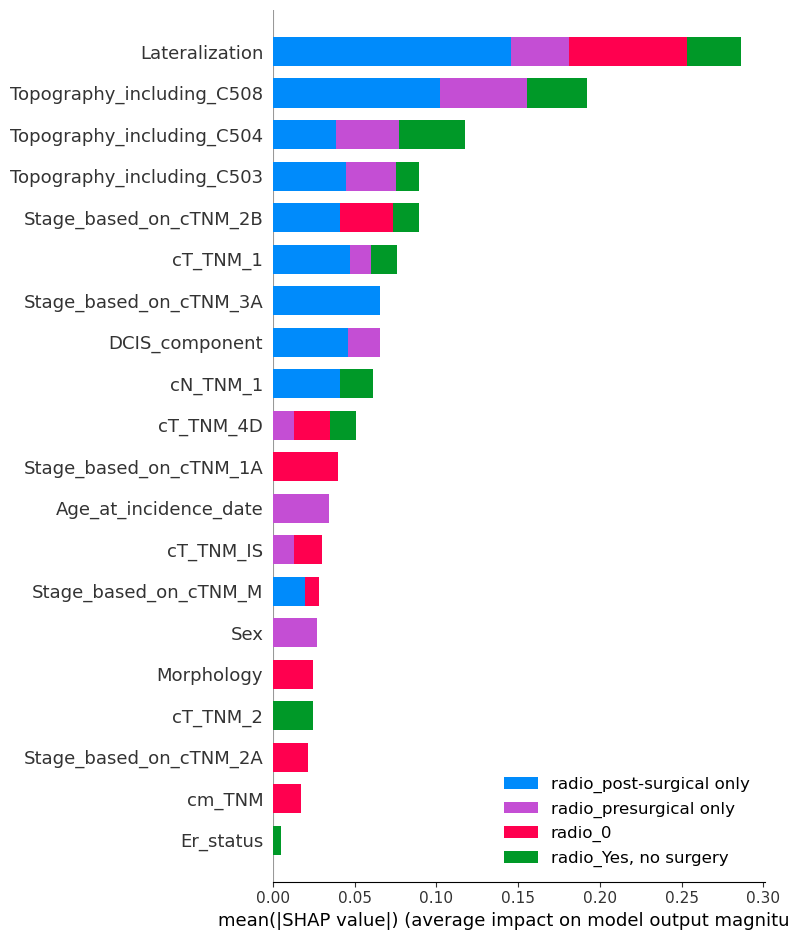

predicted_class= 2


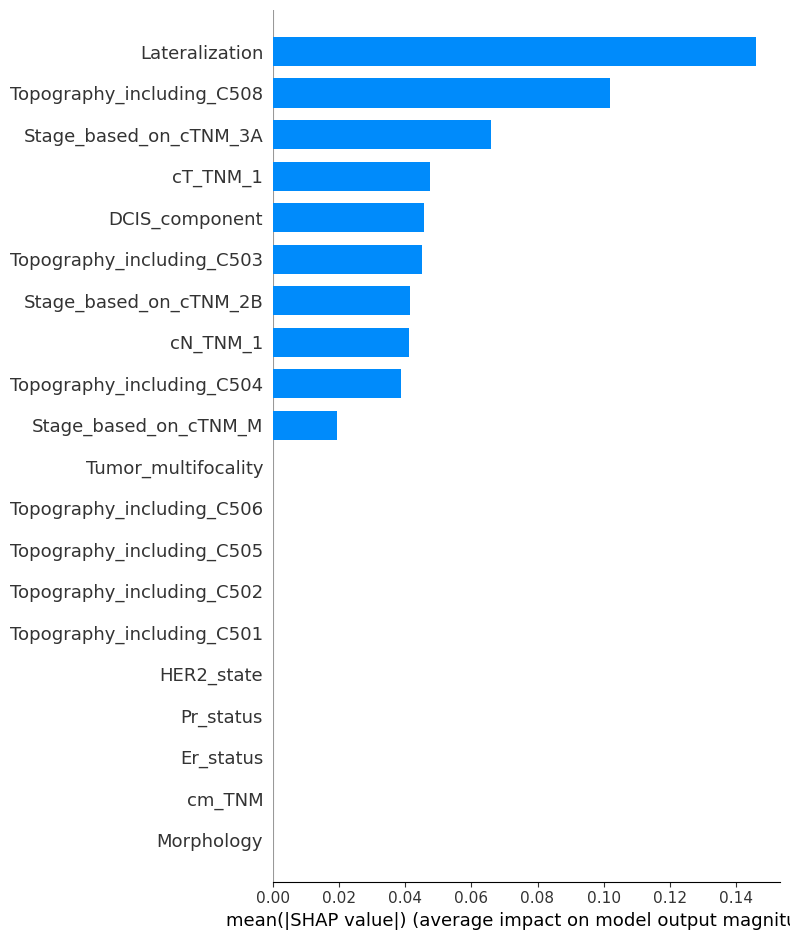

Values for surgery
Origianl dataset shape: Counter({0: 35853, 1: 3657})
Resampple dataset shape: Counter({0: 35853, 1: 35853})
Actual class: 0
Predicted class: 0
Prediction for 1st sample in X_test: [0.91333333 0.08666667]


  0%|          | 0/1 [00:00<?, ?it/s]

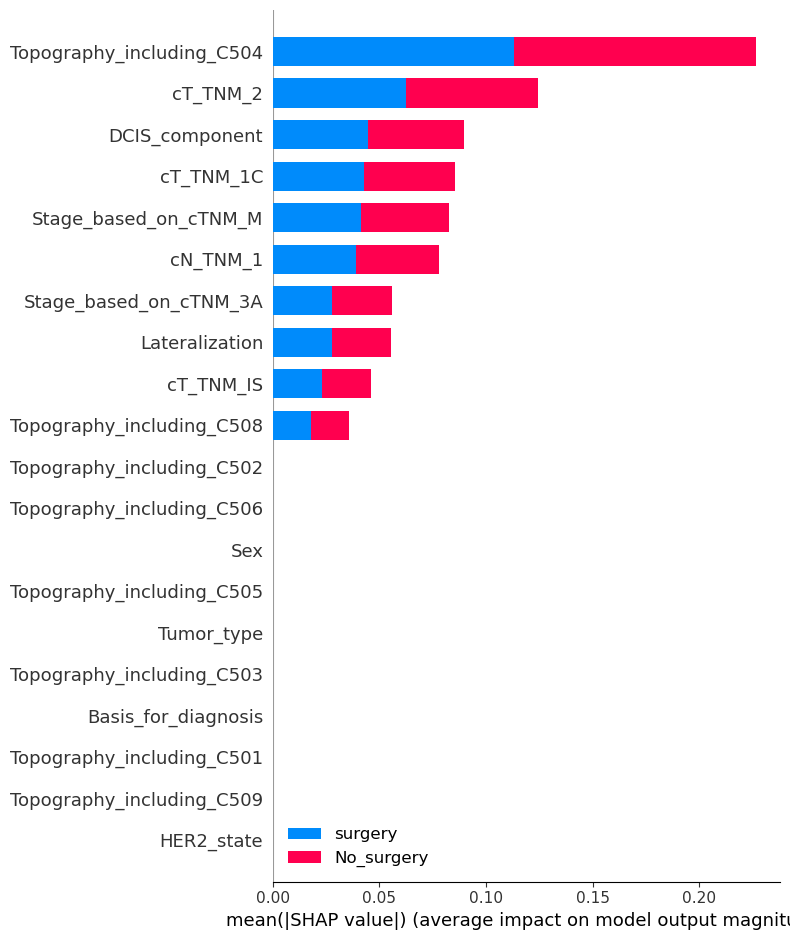

predicted_class= 0


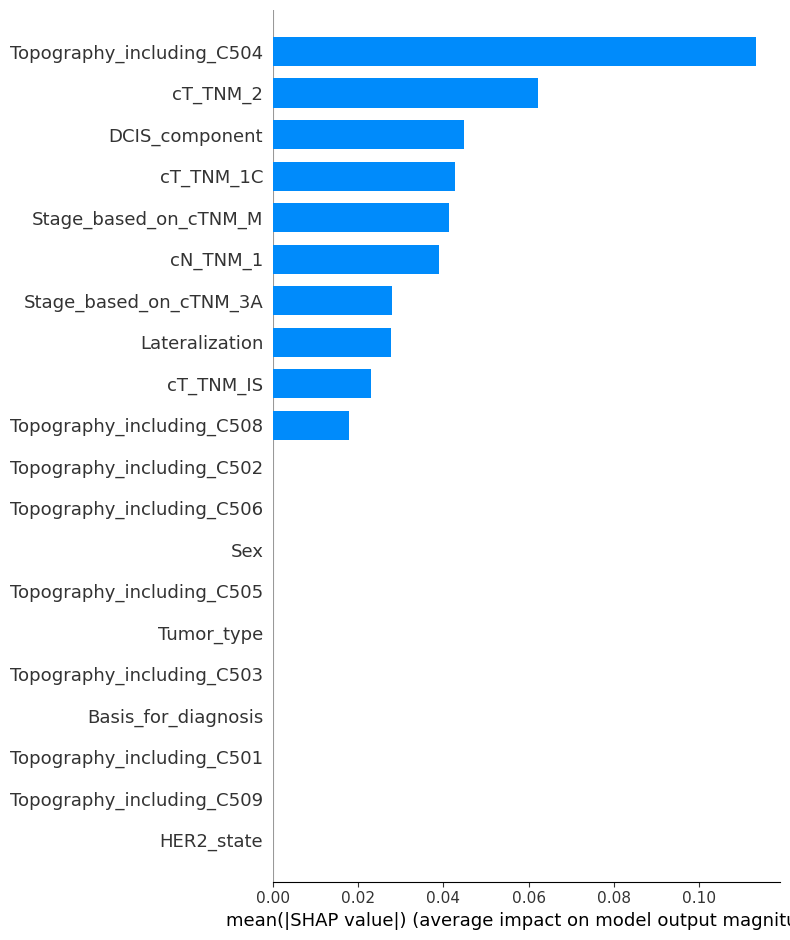

In [286]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['chemo_0','chemo_presurgical only','chemo_post-surgical only','chemo_pre and post surgical','chemo_Yes, no surgery'],
        'target':['target_0','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['hormonal_0','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['radio_0','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['No_surgery','surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}

for i in Y:
    y=Y[i]
    smote = SMOTE(random_state=42)
    
    X_class_resampled, y_class_resampled = smote.fit_resample(X , y)
    
    X_class_resampled.replace({False: 0, True: 1}, inplace=True)
    y_class_resampled.replace({False:0, True:1}, inplace= True)
    
    print('Values for', i)
    print('Origianl dataset shape:', Counter(y))
    print('Resampple dataset shape:', Counter(y_class_resampled))

    x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

    x_train.reset_index(drop=True, inplace=True)
    y_train.reset_index(drop=True, inplace=True)
    x_test.reset_index(drop=True, inplace=True)
    y_test.reset_index(drop=True, inplace=True)

    #X_res, y_res = sm.fit_resample(x_train, y_train)

    #Randomforest Classifier
    rf = RandomForestClassifier()
    rf.fit(x_train, y_train)
    y_pred = rf.predict(x_test)
    
    
    #LIME explainer single instance
    explainer = LimeTabularExplainer(x_train.values, 
                                 feature_names=x_train.columns, 
                                 class_names=classes_names[y_test.name], 
                                 discretize_continuous=True)

    # Choose a sample to explain
    j = 2
    sample = x_test.iloc[[j], :]
    print(f'Actual class: {y_test[j]}')
    print(f'Predicted class: {rf.predict(sample)[0]}')
    print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[3], :])[0]}')

    # Explain the prediction for the chosen sample
    #explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=4, top_labels=4)


    # Visualize the explanation
   # explanation.show_in_notebook(show_table=True, show_all=False)
    
    
    
    #Shap Explainer single instance 
    
    # Define the number of samples to summarize the background data
    K = 100  # Choose an appropriate value for K

    # Summarize the background data using shap.sample()
    background_sample = shap.sample(x_train, K)

    # Use the summarized background sample in your SHAP model
    explainer = shap.KernelExplainer(model=rf.predict_proba, data=background_sample)
    
    #shap_values = explainer.shap_values(x_test.iloc[[1], :], nsamples=100)
    shap_values = explainer.shap_values(sample, nsamples=100, l1_reg="num_features(10)")



    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

    plt.show()
    
    # for single label explanation    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

    predicted_class= rf.predict(sample)[0]
    print('predicted_class=', predicted_class)
    shap.summary_plot(shap_values[predicted_class], feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=True)

    plt.show()
    
   


# Below is for shap individual 

In [514]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['chemo_0','chemo_presurgical only','chemo_post-surgical only','chemo_pre and post surgical','chemo_Yes, no surgery'],
        'target':['target_0','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['hormonal_0','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['radio_0','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['No_surgery','surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}


y=Y['chemo']
smote = SMOTE(random_state=42)

X_class_resampled, y_class_resampled = smote.fit_resample(X , y)

X_class_resampled.replace({False: 0, True: 1}, inplace=True)
y_class_resampled.replace({False:0, True:1}, inplace= True)

print('Values for', i)
print('Origianl dataset shape:', Counter(y))
print('Resampple dataset shape:', Counter(y_class_resampled))

x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

#X_res, y_res = sm.fit_resample(x_train, y_train)

#Randomforest Classifier
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)


#LIME explainer single instance
explainer = LimeTabularExplainer(x_train.values, 
                             feature_names=x_train.columns, 
                             class_names=classes_names[y_test.name], 
                             discretize_continuous=True)

# Choose a sample to explain
j = 3
sample = x_test.iloc[[j], :]
print(f'Actual class: {y_test[j]}')
print(f'Predicted class: {rf.predict(sample)[0]}')
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[3], :])[0]}')

# Explain the prediction for the chosen sample
explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=25, top_labels=10)


# Visualize the explanation
explanation.show_in_notebook(show_table=True, show_all=False)



#LIME explainer single instance
    explainer = LimeTabularExplainer(x_train.values, 
                                 feature_names=x_train.columns, 
                                 class_names=classes_names[y_test.name], 
                                 discretize_continuous=True)

    # Choose a sample to explain
    j = 0
    sample = x_test.iloc[j].values.reshape(1, -1)
    print(f'Actual class: {y_test[j]}')
    print(f'Predicted class: {rf.predict(sample)[0]}')

    # Explain the prediction for the chosen sample
    explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=4, top_labels=4)


    # Visualize the explanation
    explanation.show_in_notebook(show_table=True, show_all=False)
    
    
    
    #Shap Explainer single instance 
    
    explainer = shap.TreeExplainer(rf)
    #explainer = shap.KernelExplainer(rf.predict,x_train)
    # Calculate shapley values for test data


    print('Shap Plot for same instance')
    # Choose a sample to explain

    shap_values = explainer.shap_values(sample)
    

    #shap.force_plot(explainer.expected_value[0],
    #                shap_values[1],
    #                sample) # for values


    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)
    
    plt.show()

    # Create a KernelExplainer

   


Values for surgery
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Actual class: 4
Predicted class: 4
Prediction for 1st sample in X_test: [0. 0. 0. 0. 1.]


KeyError: 0

In [342]:
shap_valuesss = shap_values[predicted_class][0]
shap_valuesss

array([0.11002588, 0.        , 0.03647136, 0.        , 0.06077862,
       0.        , 0.        , 0.        , 0.        , 0.08562888,
       0.02082398, 0.        , 0.        , 0.        , 0.        ,
       0.01737461, 0.02259857, 0.        , 0.01903257, 0.        ,
       0.        , 0.05926401, 0.        , 0.        , 0.02786874,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.05910292, 0.        , 0.        ,
       0.00204249, 0.02192013, 0.        , 0.        , 0.12450086,
       0.07375829, 0.        , 0.        , 0.        , 0.        ,
       0.0278214 ])

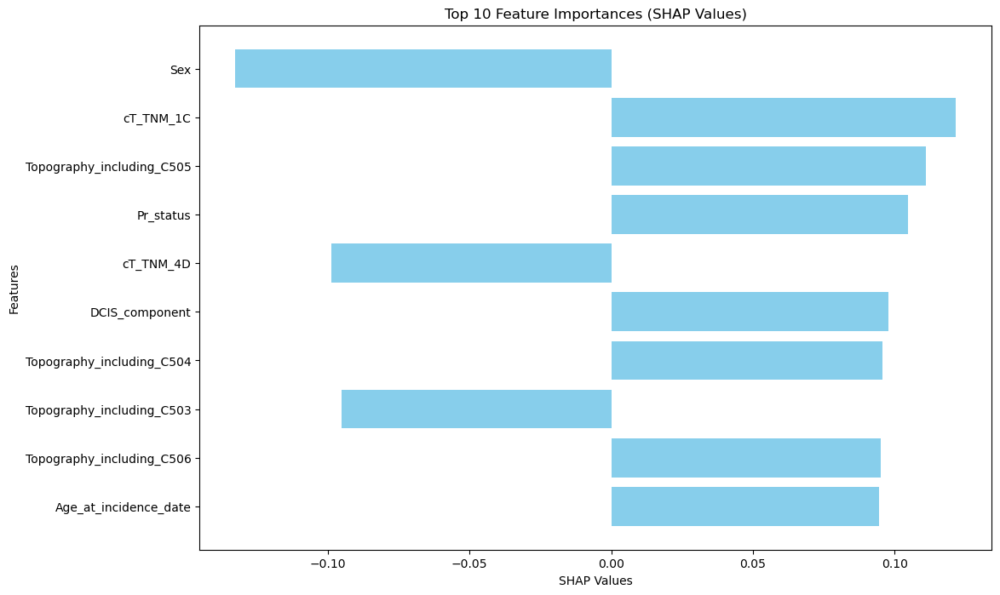

In [301]:
import numpy as np
import matplotlib.pyplot as plt

# Your given data
shap_values = np.array([[0.09448379, -0.13254803, 0.0, 0.02471993, 0.0, 0.0, 0.0, 0.06002808, 0.10454518, 0.08227607, 0.09786801, 0.03683819, 0.04533723, 0.03908481, -0.09507114, 0.09579643, 0.11100852, 0.09494059, 0.0, -0.02087526, -0.00466435, -0.03216771, 0.02197531, 0.12145945, 0.0, 0.08884367, -0.04598742, 0.0, 0.05056371, -0.03640725, -0.09867409, 0.0, 0.03400387, 0.0, 0.0, 0.0, -0.01438918, 0.0, 0.0, 0.0, 0.0, -0.03021992, 0.04598459, 0.0, 0.0, -0.05305681]])
column_names = ['Age_at_incidence_date', 'Sex', 'Tumor_type', 'Basis_for_diagnosis', 'Lateralization', 'Morphology', 'cm_TNM', 'Er_status', 'Pr_status', 'HER2_state', 'DCIS_component', 'Tumor_multifocality', 'Topography_including_C501', 'Topography_including_C502', 'Topography_including_C503', 'Topography_including_C504', 'Topography_including_C505', 'Topography_including_C506', 'Topography_including_C508', 'Topography_including_C509', 'cT_TNM_1', 'cT_TNM_1A', 'cT_TNM_1B', 'cT_TNM_1C', 'cT_TNM_1M', 'cT_TNM_2', 'cT_TNM_3', 'cT_TNM_4A', 'cT_TNM_4B', 'cT_TNM_4C', 'cT_TNM_4D', 'cT_TNM_IS', 'cN_TNM_1', 'cN_TNM_2A', 'cN_TNM_2B', 'cN_TNM_3A', 'cN_TNM_3B', 'cN_TNM_3C', 'Stage_based_on_cTNM_1A', 'Stage_based_on_cTNM_2A', 'Stage_based_on_cTNM_2B', 'Stage_based_on_cTNM_3A', 'Stage_based_on_cTNM_3B', 'Stage_based_on_cTNM_3C', 'Stage_based_on_cTNM_4', 'Stage_based_on_cTNM_M']

# Extract non-zero SHAP values and their corresponding indices
non_zero_indices = np.nonzero(shap_values[0])[0]
non_zero_shap_values = shap_values[0, non_zero_indices]

# Map indices to column names
non_zero_column_names = [column_names[i] for i in non_zero_indices]

# Combine and sort by absolute SHAP value
combined_list = list(zip(non_zero_column_names, non_zero_shap_values))
sorted_combined_list = sorted(combined_list, key=lambda x: abs(x[1]), reverse=True)

# Select top 10
top_10_combined_list = sorted_combined_list[:10]

# Unzip into two lists
top_10_column_names, top_10_shap_values = zip(*top_10_combined_list)

# Create the horizontal bar plot
plt.figure(figsize=(12, 8))
plt.barh(top_10_column_names, top_10_shap_values, color='skyblue')
plt.xlabel('SHAP Values')
plt.ylabel('Features')
plt.title('Feature Importances summery of SHAP Values')
plt.gca().invert_yaxis()  # Ensure the highest value is at the top
plt.show()


In [307]:
shap_values[predicted_class][0]

array([ 0.01545617,  0.        ,  0.01950435,  0.        ,  0.03836348,
        0.        ,  0.        ,  0.        ,  0.00929527,  0.06865513,
        0.05430685,  0.        ,  0.02182546,  0.0269113 ,  0.        ,
        0.07304908,  0.        ,  0.        , -0.02142201,  0.01859995,
        0.        ,  0.        ,  0.03428205,  0.        ,  0.        ,
        0.01839955,  0.        ,  0.        ,  0.        ,  0.02028201,
        0.01099715,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.01555693,  0.        ,  0.        ,  0.0346552 ,
        0.        ,  0.0003956 ,  0.        ,  0.        ,  0.        ,
        0.        ])

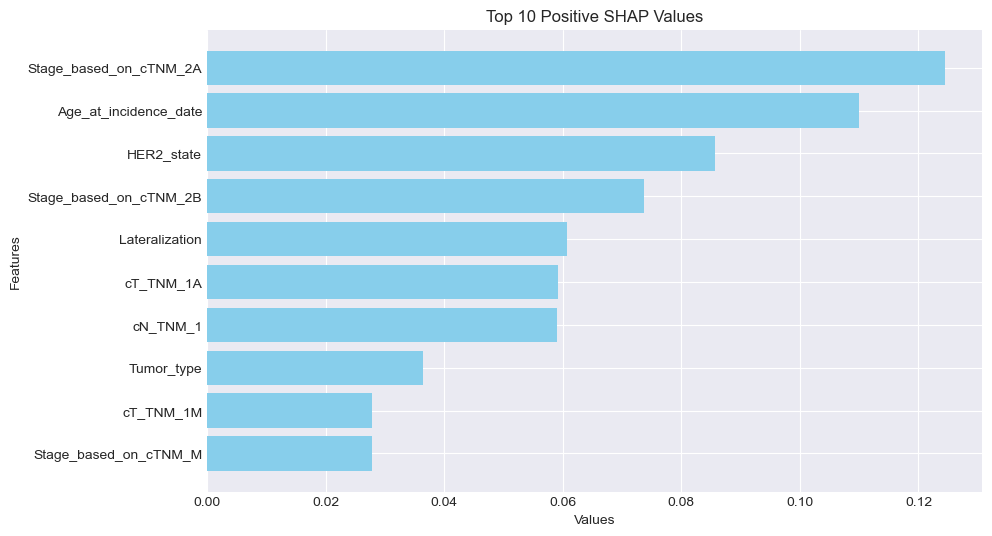

In [343]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names
shap_valuesss = shap_values[predicted_class][0]
column_namesss = x_train.columns
# Flatten shap_values array
#shap_values = shap_values.flatten()

# Filter positive SHAP values
positive_shap_indices = np.where(shap_valuesss > 0)[0]
positive_shap_values = shap_valuesss[positive_shap_indices]
positive_shap_columns = np.array(column_namesss)[positive_shap_indices]

# Combine and sort by SHAP values
positive_shap_list = list(zip(positive_shap_columns, positive_shap_values))
positive_shap_list.sort(key=lambda x: x[1], reverse=True)

# Select top 10
top_10_shap = positive_shap_list[:10]

# Unzip to get column names and values
top_10_columns, top_10_values = zip(*top_10_shap)

# Plot the horizontal bar graph
plt.figure(figsize=(10, 6))
plt.barh(top_10_columns, top_10_values, color='skyblue')
plt.xlabel('Values')
plt.ylabel('Features')
plt.title('Top 10 Positive SHAP Values')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest value at the top
plt.show()


The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.


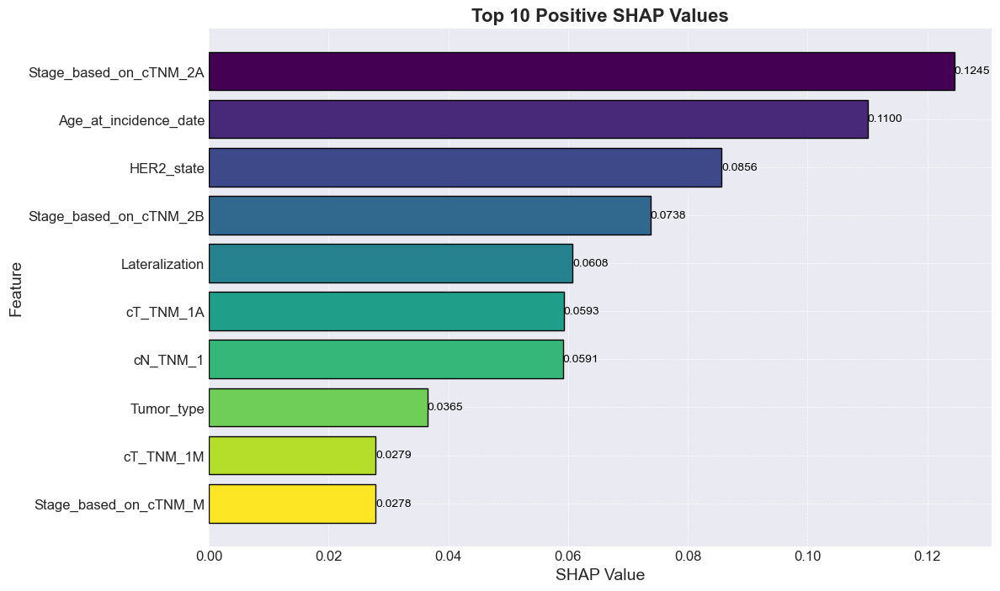

In [344]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values of pridicted label and column names
shap_valuesss = shap_values[predicted_class][0]
column_namesss = x_train.columns

# Filter positive SHAP values
positive_shap_indices = np.where(shap_valuesss > 0)[0]
positive_shap_values = shap_valuesss[positive_shap_indices]
positive_shap_columns = np.array(column_namesss)[positive_shap_indices]

# Combine and sort by SHAP values
positive_shap_list = list(zip(positive_shap_columns, positive_shap_values))
positive_shap_list.sort(key=lambda x: x[1], reverse=True)

# Select top 10
top_10_shap = positive_shap_list[:10]

# Unzip to get column names and values
top_10_columns, top_10_values = zip(*top_10_shap)

# Set plot style
plt.style.use('seaborn-darkgrid')

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(12, 8))
bars = ax.barh(top_10_columns, top_10_values, color=plt.cm.viridis(np.linspace(0, 1, len(top_10_values))), edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left', fontsize=10, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('SHAP Value', fontsize=14)
ax.set_ylabel('Feature', fontsize=14)
ax.set_title('Top 10 Positive SHAP Values', fontsize=16, fontweight='bold')

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

plt.show()


In [290]:
shap_values[predicted_class]

array([[ 0.09448379, -0.13254803,  0.        ,  0.02471993,  0.        ,
         0.        ,  0.        ,  0.06002808,  0.10454518,  0.08227607,
         0.09786801,  0.03683819,  0.04533723,  0.03908481, -0.09507114,
         0.09579643,  0.11100852,  0.09494059,  0.        , -0.02087526,
        -0.00466435, -0.03216771,  0.02197531,  0.12145945,  0.        ,
         0.08884367, -0.04598742,  0.        ,  0.05056371, -0.03640725,
        -0.09867409,  0.        ,  0.03400387,  0.        ,  0.        ,
         0.        , -0.01438918,  0.        ,  0.        ,  0.        ,
         0.        , -0.03021992,  0.04598459,  0.        ,  0.        ,
        -0.05305681]])

# Below is for LIME individual 

In [515]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


#X = data.loc[:, ~data.columns.isin(['chemo','target','hormonal','radio','surgery'])]
#Y = data[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','without surgery'],
        'target':['target_0','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['hormonal_0','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['radio_0','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['No_surgery','surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}


y=Y['chemo']
smote = SMOTE(random_state=42)

X_class_resampled, y_class_resampled = smote.fit_resample(X , y)

X_class_resampled.replace({False: 0, True: 1}, inplace=True)
y_class_resampled.replace({False:0, True:1}, inplace= True)

print('Values for', i)
print('Origianl dataset shape:', Counter(y))
print('Resampple dataset shape:', Counter(y_class_resampled))

x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

#X_res, y_res = sm.fit_resample(x_train, y_train)

#Randomforest Classifier
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)


#LIME explainer single instance
explainer = LimeTabularExplainer(x_train.values, 
                             feature_names=x_train.columns, 
                             class_names=classes_names[y_test.name], 
                             discretize_continuous=True)

# Choose a sample to explain
j = 0
sample = x_test.iloc[j].values.reshape(1, -1)
print(f'Actual class: {y_test[j]}')
print(f'Predicted class: {rf.predict(sample)[0]}')

# Explain the prediction for the chosen sample
explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=10, top_labels=10)


# Visualize the explanation
#explanation.show_in_notebook(show_table=True, show_all=False)
    




Values for surgery
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Actual class: 1
Predicted class: 2


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


In [516]:
Predicted_class= rf.predict(sample)[0]
Predicted_class

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


2

In [519]:
explanation.available_labels()


[2, 1, 4, 0, 3]

In [520]:
explanation.show_in_notebook(show_table=True, show_all=False)

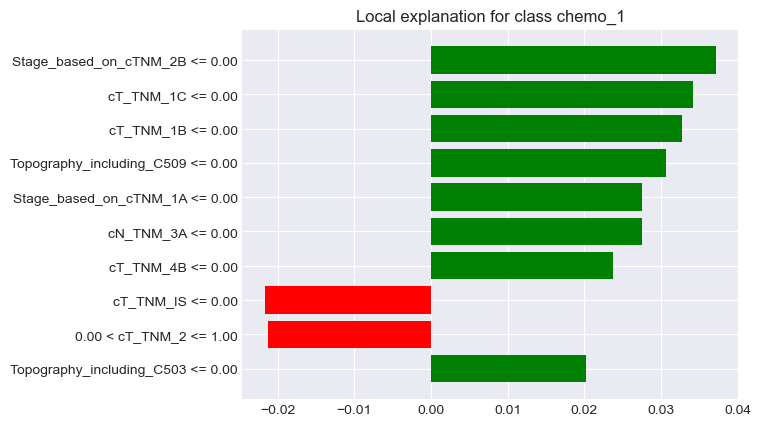

In [521]:
fig = explanation.as_pyplot_figure(label=1)

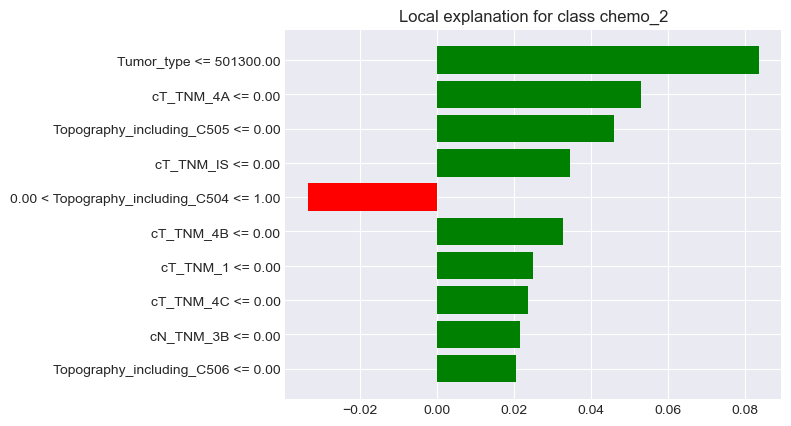

In [522]:
fig = explanation.as_pyplot_figure(label=Predicted_class)

In [523]:
pd.DataFrame(explanation.as_list(),columns=['Feature','Contribution'])

,Feature,Contribution
0,Stage_based_on_cTNM_2B <= 0.00,0.037153
1,cT_TNM_1C <= 0.00,0.034189
2,cT_TNM_1B <= 0.00,0.032790
3,Topography_including_C509 <= 0.00,0.030627
4,Stage_based_on_cTNM_1A <= 0.00,0.027578
5,cN_TNM_3A <= 0.00,0.027465
6,cT_TNM_4B <= 0.00,0.023718
7,cT_TNM_IS <= 0.00,-0.021632
8,0.00 < cT_TNM_2 <= 1.00,-0.021194
9,Topography_including_C503 <= 0.00,0.020224


In [329]:
explanation.local_exp

{4: [(2, -0.07700240294881047),
  (27, -0.056775289942250104),
  (28, -0.055883155881251236),
  (31, -0.0473322891369209),
  (29, -0.03451908285116715),
  (16, -0.03333116639123944),
  (11, 0.03247099652798226),
  (20, -0.03194408256407634),
  (40, -0.030264090390914152),
  (6, -0.028103128610042664)],
 1: [(43, -0.04464909675930268),
  (22, 0.0324436277267962),
  (31, -0.030012342841780313),
  (23, -0.028470254703565966),
  (19, 0.02844424791169275),
  (30, -0.027607368290750195),
  (40, 0.025446171016892817),
  (38, -0.025141975679821432),
  (25, 0.024105765734251255),
  (20, 0.02131416568753593)],
 3: [(2, 0.05323612947434573),
  (22, -0.0450340288815818),
  (23, 0.04404790019245989),
  (27, 0.040192713993494056),
  (29, 0.035427909443500806),
  (38, 0.03179211756738204),
  (31, 0.03144545933682138),
  (30, 0.025673301397158926),
  (43, 0.02495476494389545),
  (28, 0.02388334653104506)],
 0: [(4, 0.021356156764146258),
  (7, -0.020120389930745847),
  (38, -0.017970927407512743),
  (

In [330]:
explanation.local_exp[Predicted_class]

[(31, 0.0480393309393573),
 (2, 0.0450709273507123),
 (15, 0.04479868303175772),
 (43, 0.03972108272461131),
 (27, 0.03862061974807002),
 (28, 0.03510498293545132),
 (16, 0.03355355468561816),
 (20, 0.02587207035565834),
 (30, 0.021914292151457692),
 (35, 0.021546133731250205)]

In [526]:
x_test.iloc[0].values.reshape(1, -1)

array([[6.80000000e+01, 2.00000000e+00, 5.01300000e+05, 7.00000000e+00,
        1.19293444e+00, 8.50000000e+03, 0.00000000e+00, 1.00000000e+00,
        1.00000000e+00, 0.00000000e+00, 1.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        1.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00]])

In [532]:
j=0
sample= x_test.iloc[j]
sample

Age_at_incidence_date            68.000000
Sex                               2.000000
Tumor_type                   501300.000000
Basis_for_diagnosis               7.000000
Lateralization                    1.192934
Morphology                     8500.000000
cm_TNM                            0.000000
Er_status                         1.000000
Pr_status                         1.000000
HER2_state                        0.000000
DCIS_component                    1.000000
Tumor_multifocality               0.000000
Topography_including_C501         0.000000
Topography_including_C502         0.000000
Topography_including_C503         0.000000
Topography_including_C504         1.000000
Topography_including_C505         0.000000
Topography_including_C506         0.000000
Topography_including_C508         0.000000
Topography_including_C509         0.000000
cT_TNM_1                          0.000000
cT_TNM_1A                         0.000000
cT_TNM_1B                         0.000000
cT_TNM_1C  

In [557]:

# Choose a sample to explain
j = 0
sample = x_test.iloc[j]

# %% Create SHAP explainer

explainer = shap.TreeExplainer(rf)
# Calculate shapley values for test data
start_index = 0
end_index = 1
shap_values = explainer.shap_values(x_test[start_index:end_index])






In [554]:
shap_values

[array([-7.06035698e-03,  6.19794040e-05,  4.82150029e-04,  1.09058017e-04,
        -1.68517779e-01, -2.95644513e-03, -1.38050391e-03,  1.79900575e-03,
         1.75331134e-02, -6.05422375e-03,  2.57036788e-02, -3.75637387e-03,
         2.98657320e-03,  6.40301880e-03,  2.44785724e-03, -4.64274966e-02,
         5.40229665e-03,  7.32353647e-04,  1.59227374e-02,  1.42281975e-03,
         1.61268479e-04,  2.74618731e-04,  4.32088518e-03,  1.31341865e-02,
         1.19262512e-04, -4.26259777e-02,  4.24043907e-03,  8.37914306e-04,
        -1.00100757e-04,  7.17486511e-04,  3.01471289e-04,  3.06919784e-03,
        -1.80863333e-02,  1.42230672e-05,  4.77915402e-07,  2.20590661e-04,
         4.34114507e-05,  8.79238632e-05,  2.42292013e-02, -3.93041295e-02,
         1.88539288e-02,  7.53899885e-04,  1.64563235e-03,  7.95015318e-04,
         2.63603038e-04,  3.40137983e-04]),
 array([ 5.57153161e-03,  3.46597100e-04,  5.11035888e-05,  1.98288720e-03,
         3.31554316e-02,  1.95040664e-03,  2

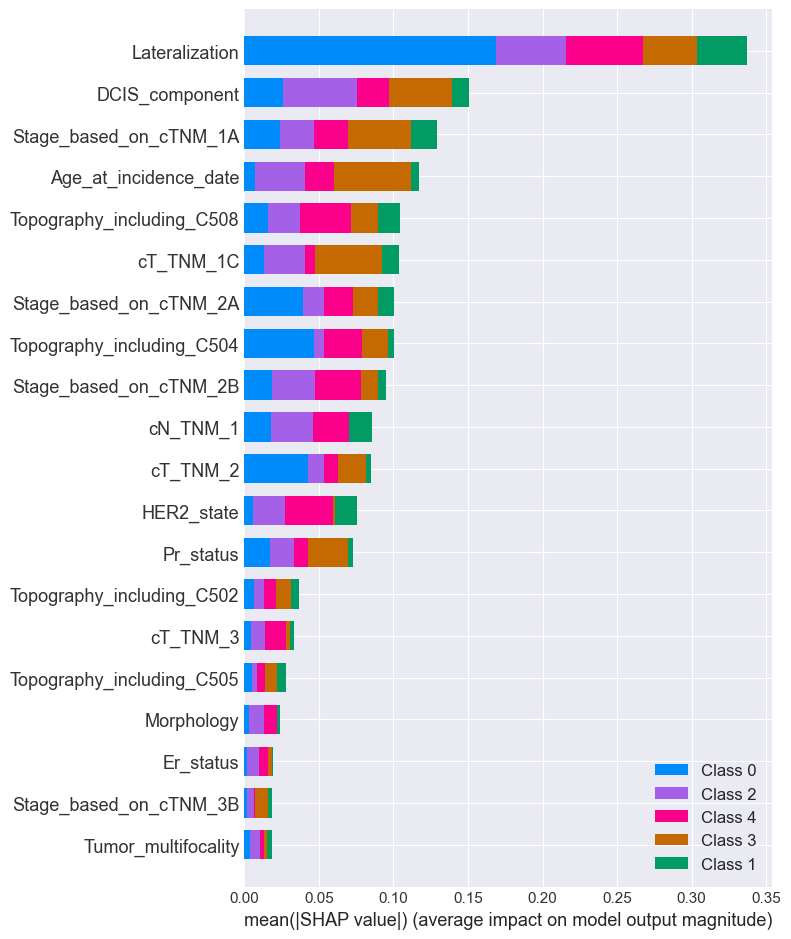

In [559]:
#shap.force_plot(explainer.expected_value[0],
#                shap_values[1],
#                sample) # for values


shap.summary_plot(shap_values, feature_names=x_train.columns, plot_type="bar", show=False)

plt.show()

# Create a KernelExplainer

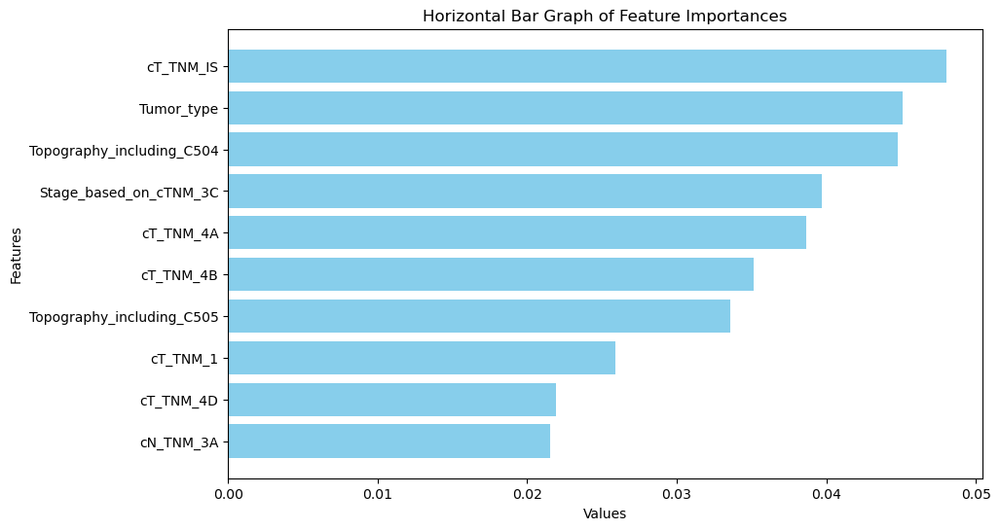

In [331]:
lime_values_of_Prid_cls= explanation.local_exp[Predicted_class]

positive_list = [(x, y) for x, y in lime_values_of_Prid_cls if y > 0]
# Separate the x and y values
x_values = [x for x, y in positive_list]
x_names = [column_names[t] for t in x_values]
y_values = [y for x, y in positive_list]

# Combine x_names and y_values into a list of tuples and sort by y_values
sorted_list = sorted(zip(x_names, y_values), key=lambda pair: pair[1])

# Unzip the sorted list
x_names_sorted, y_values_sorted = zip(*sorted_list)

# Create the horizontal bar plot
plt.figure(figsize=(10, 6))
plt.barh(x_names_sorted, y_values_sorted, color='skyblue')
plt.xlabel('Values')
plt.ylabel('Features')
plt.title('Horizontal Bar Graph of Feature Importances')
plt.show()

In [275]:
y_values

[0.05038829625853256,
 0.04820167508433331,
 0.04384800034326171,
 0.039515841285602905,
 0.03444611776007411,
 0.026987894473819656,
 0.02524576791431244,
 0.020973691498433988]

In [277]:
x_names

['Tumor_type',
 'cT_TNM_4A',
 'cT_TNM_4C',
 'cT_TNM_1C',
 'Stage_based_on_cTNM_1A',
 'cN_TNM_3B',
 'cT_TNM_4B',
 'cT_TNM_IS']

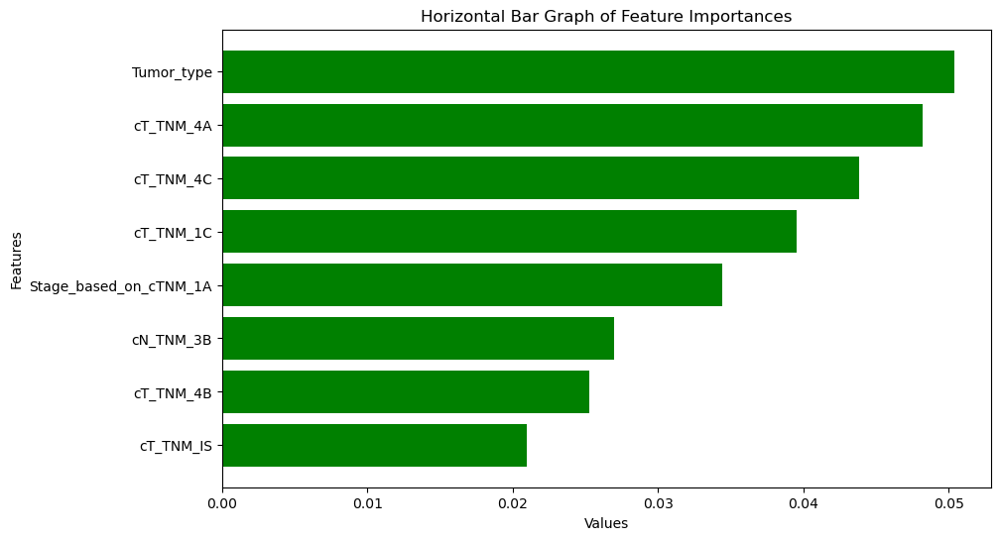

In [282]:
# Combine x_names and y_values into a list of tuples and sort by y_values
sorted_list = sorted(zip(x_names, y_values), key=lambda pair: pair[1])

# Unzip the sorted list
x_names_sorted, y_values_sorted = zip(*sorted_list)

# Create the horizontal bar plot
plt.figure(figsize=(10, 6))
plt.barh(x_names_sorted, y_values_sorted, color='Green')
plt.xlabel('Values')
plt.ylabel('Features')
plt.title('Horizontal Bar Graph of Feature Importances')
plt.show()

#

Pick a sample before train test split and test it for treatment prediction

Values for chemo
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
Actual class: 0
Predicted class: 0


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


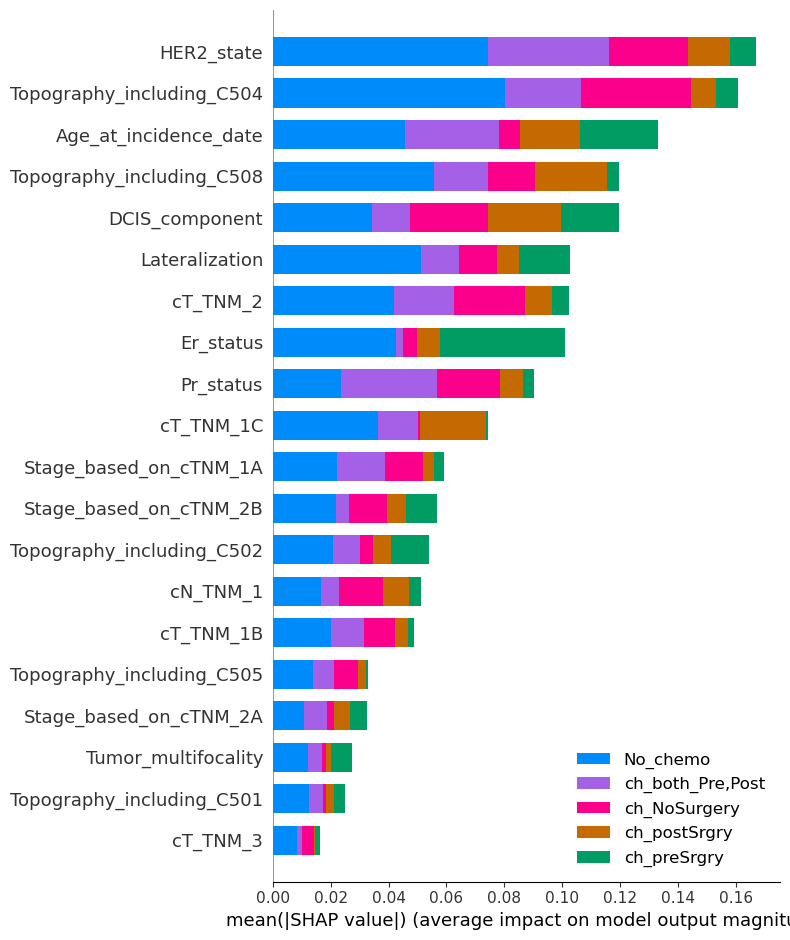

Values for target
Origianl dataset shape: Counter({0: 33726, 2: 2182, 3: 2072, 1: 933, 4: 597})
Resampple dataset shape: Counter({4: 33726, 0: 33726, 2: 33726, 3: 33726, 1: 33726})
Actual class: 0
Predicted class: 4


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


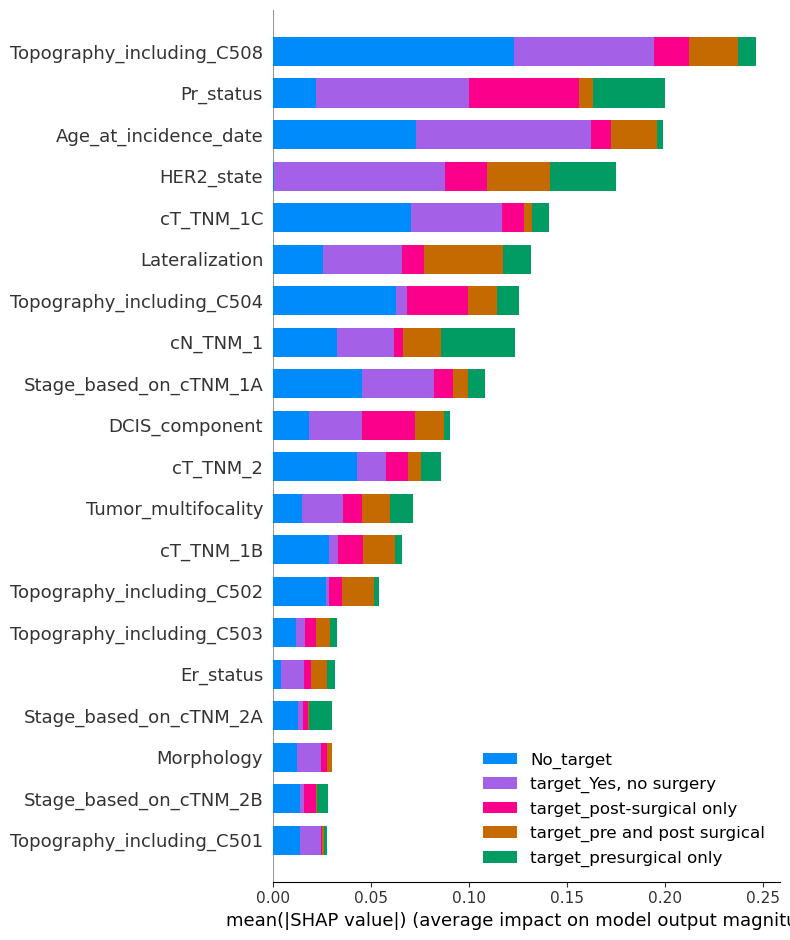

Values for hormonal
Origianl dataset shape: Counter({2: 19788, 0: 15809, 4: 2582, 3: 1078, 1: 253})
Resampple dataset shape: Counter({0: 19788, 2: 19788, 4: 19788, 1: 19788, 3: 19788})
Actual class: 0
Predicted class: 0


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


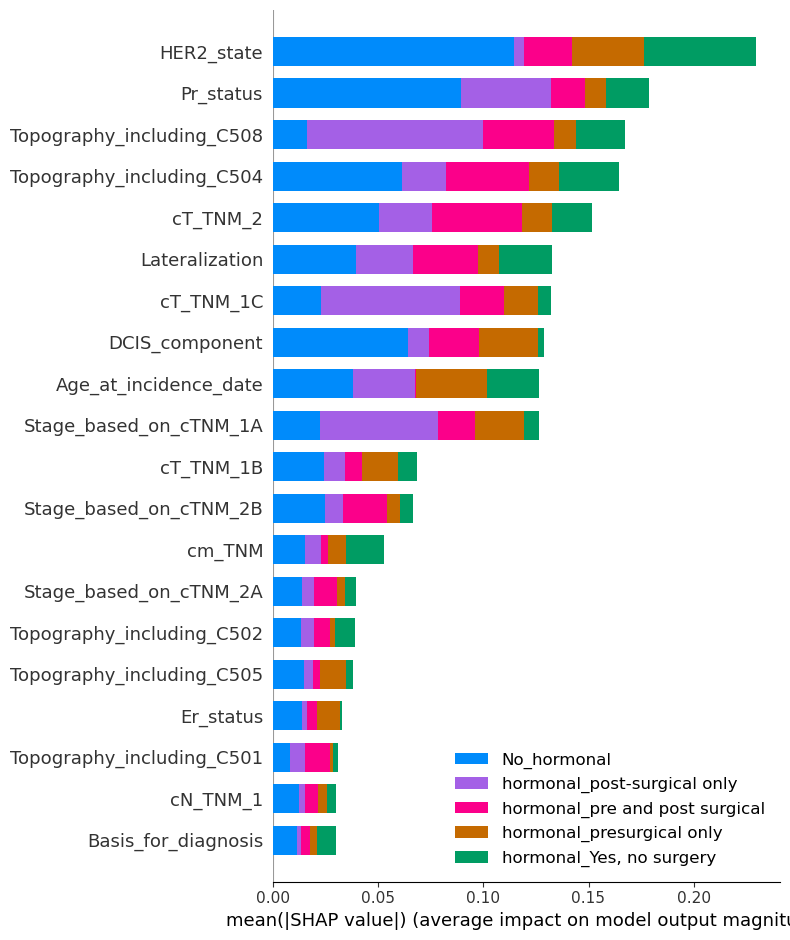

Values for radio
Origianl dataset shape: Counter({2: 25357, 0: 12592, 1: 845, 4: 716})
Resampple dataset shape: Counter({0: 25357, 2: 25357, 4: 25357, 1: 25357})
Actual class: 0
Predicted class: 0


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


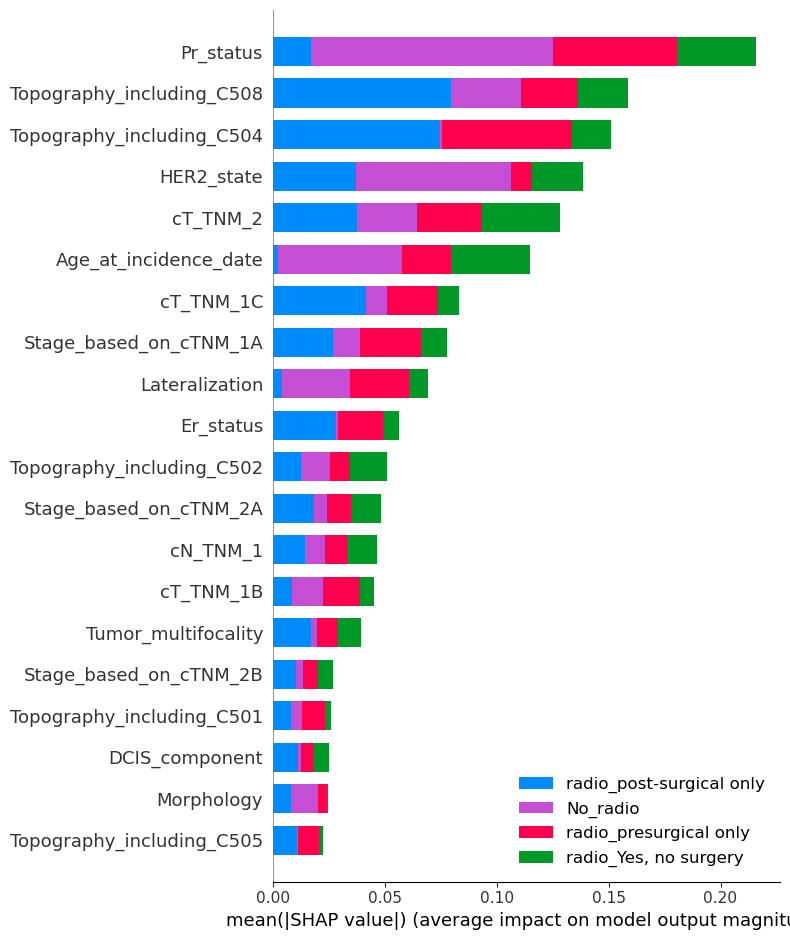

Values for surgery
Origianl dataset shape: Counter({0: 35853, 1: 3657})
Resampple dataset shape: Counter({0: 35853, 1: 35853})
Actual class: 0
Predicted class: 0


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Shap Plot for same instance


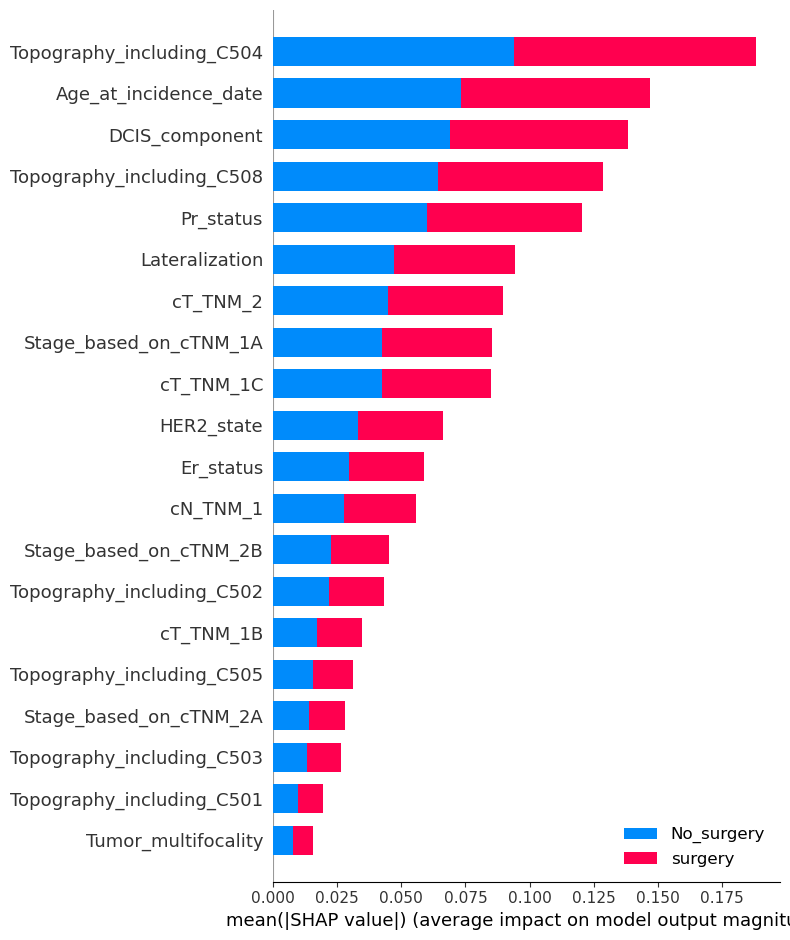

In [486]:

from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
import shap


X = DATA.loc[:, ~DATA.columns.isin(['chemo','target','hormonal','radio','surgery'])]
Y = DATA[['chemo','target','hormonal','radio','surgery']]

#smote canot work with multiple_outcome, select single outcome at a time a bulding a random forest for this single outcome
#store the result in Accuracies, f1_scores, recalls, and precisions matrices against each outcome.
accuracies,precisions, recalls, f1_scores = [], [], [], []
#y_test are the randomly choosen values form the dataset so it needs to rest the index for y_test 
classes_names = {'chemo':['No_chemo','ch_preSrgry','ch_postSrgry','ch_both_Pre,Post','ch_NoSurgery'],
        'target':['No_target','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['No_hormonal','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['No_radio','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['surgery', 'No_surgery']}

#classes_names = {'chemo':['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'],
#        'target':['target_0','target_1','target_2','target_3','target_4'],
#        'hormonal':['hormonal_0','hormonal_1','hormonal_2','hormonal_3','hormonal_4'],
#        'radio':['radio_0','radio_1','radio_2','radio_4'],
#        'surgery':['surgery', 'No_surgery']}

# Choose a sample to explain
row_index = 4
j=0
X_row_data = X.iloc[row_index].values.reshape(1, -1)
x_sample= tt.astype(int)
y_sample=Y.iloc[row_index].values

for i in Y:
    y=Y[i]
    smote = SMOTE(random_state=42)
    
    X_class_resampled, y_class_resampled = smote.fit_resample(X , y)
    
    X_class_resampled.replace({False: 0, True: 1}, inplace=True)
    y_class_resampled.replace({False:0, True:1}, inplace= True)
    
    print('Values for', i)
    print('Origianl dataset shape:', Counter(y))
    print('Resampple dataset shape:', Counter(y_class_resampled))

    x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

    x_train.reset_index(drop=True, inplace=True)
    y_train.reset_index(drop=True, inplace=True)
    x_test.reset_index(drop=True, inplace=True)
    y_test.reset_index(drop=True, inplace=True)

    #X_res, y_res = sm.fit_resample(x_train, y_train)
    
    #Randomforest Classifier
    rf = RandomForestClassifier()
    rf.fit(x_train, y_train)
    y_pred = rf.predict(x_test)
    
    sample=x_sample.reshape(1, -1)
    print(f'Actual class: {y_sample[j]}')
    print(f'Predicted class: {rf.predict(sample)[0]}')
    j+=1 #next class pridiction
    
    #LIME explainer single instance
    explainer = LimeTabularExplainer(x_train.values, 
                                 feature_names=x_train.columns, 
                                 class_names=classes_names[y_test.name],
                                 mode='classification',
                                 discretize_continuous=True)

    
    # Explain the prediction for the chosen sample
    explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=5, top_labels=10)

    # Visualize the explanation
    explanation.show_in_notebook(show_table=True, show_all=False)
    
    
    
    print(f"F1 Score {f1_score(y_test, y_pred, average='macro')}")
    print(f"Accuracy {accuracy_score(y_test, y_pred)}")
    pridct_function=rf.predict_proba


    # Define the number of samples to summarize the background data
    K = 100  # Choose an appropriate value for K

    # Summarize the background data using shap.sample()
    background_sample = shap.sample(x_train, K)

    # Use the summarized background sample in your SHAP model
    explainer = shap.KernelExplainer(model=rf.predict_proba, data=background_sample)
    
    #shap_values = explainer.shap_values(x_test.iloc[[1], :], nsamples=100)
    shap_values = explainer.shap_values(x_test[start_index:end_index], nsamples=100)



    shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

    plt.show()



In [102]:
row_index = 4
j=0
X_row_data = X.iloc[row_index].values.reshape(1, -1)
y_sample=Y.iloc[row_index].values

In [487]:
len(shap_values)

2

In [159]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, accuracy_score
from interpret.blackbox import LimeTabular
from interpret import show
from interpret.glassbox import (LogisticRegression,
                                ClassificationTree, 
                                ExplainableBoostingClassifier)
from interpret import show

from sklearn.ensemble import RandomForestClassifier
from interpret.blackbox import LimeTabular
import lime
from lime import lime_tabular

import pandas as pd
import numpy as np

Y = DATA[['chemo','target','hormonal','radio','surgery']]
X = DATA.loc[:, ~DATA.columns.isin(['chemo','target','hormonal','radio','surgery'])]
classes_names = {'chemo':['No_chemo','ch_preSrgry','ch_postSrgry','ch_both_Pre,Post','ch_NoSurgery'],
        'target':['No_target','target_presurgical only','target_post-surgical only','target_pre and post surgical','target_Yes, no surgery'],
        'hormonal':['No_hormonal','hormonal_presurgical only','hormonal_post-surgical only','hormonal_pre and post surgical','hormonal_Yes, no surgery'],
        'radio':['No_radio','radio_presurgical only','radio_post-surgical only','radio_Yes, no surgery'],
        'surgery':['surgery', 'No_surgery']}

y=Y['chemo']
smote = SMOTE(random_state=42)

X_class_resampled, y_class_resampled = smote.fit_resample(X , y)

X_class_resampled.replace({False: 0, True: 1}, inplace=True)
y_class_resampled.replace({False:0, True:1}, inplace= True)

print('Values for')
print('Origianl dataset shape:', Counter(y))
print('Resampple dataset shape:', Counter(y_class_resampled))

x_train,x_test,y_train,y_test=train_test_split(X_class_resampled,y_class_resampled,test_size=0.2)

x_train.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
x_test.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

#X_res, y_res = sm.fit_resample(x_train, y_train)



# %% Fit blackbox model
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)
print(f"F1 Score {f1_score(y_test, y_pred, average='macro')}")
print(f"Accuracy {accuracy_score(y_test, y_pred)}")
pridct_function=rf.predict_proba

import shap

# Choose a sample to explain
j = 3
sample = x_test.iloc[[j], :]
print(f'Actual class: {y_test[j]}')
print(f'Predicted class: {rf.predict(sample)[0]}')
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[3], :])[0]}')

# Define the number of samples to summarize the background data
K = 100  # Choose an appropriate value for K

# Summarize the background data using shap.sample()
background_sample = shap.sample(x_train, K)


# Use the summarized background sample in your SHAP model
# Use the summarized background sample in your SHAP model
explainer = shap.KernelExplainer(model=rf.predict_proba, data=background_sample)
start_index = 2
end_index = 3
#shap_values = explainer.shap_values(x_test.iloc[[1], :], nsamples=100)
shap_values = explainer.shap_values(sample, nsamples=100)




Values for
Origianl dataset shape: Counter({0: 24484, 2: 8941, 1: 5107, 3: 549, 4: 429})
Resampple dataset shape: Counter({0: 24484, 2: 24484, 1: 24484, 4: 24484, 3: 24484})
F1 Score 0.8010899158607906
Accuracy 0.803504329357948
Actual class: 0
Predicted class: 0
Prediction for 1st sample in X_test: [0.93916667 0.03583333 0.025      0.         0.        ]


  0%|          | 0/1 [00:00<?, ?it/s]

In [160]:
# plot the SHAP values for the Setosa output of the first instance
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[1], :])[0]}')

print(f'length of SHAP values: {len(shap_values)}')
print(f'Shape of each element: {shap_values[0].shape}')


Prediction for 1st sample in X_test: [0.63       0.11733333 0.24266667 0.         0.01      ]
length of SHAP values: 5
Shape of each element: (1, 46)


In [164]:
shap_values[3].sum()

-0.21271500000000004

In [167]:
Predicted_class=rf.predict(sample)[0]

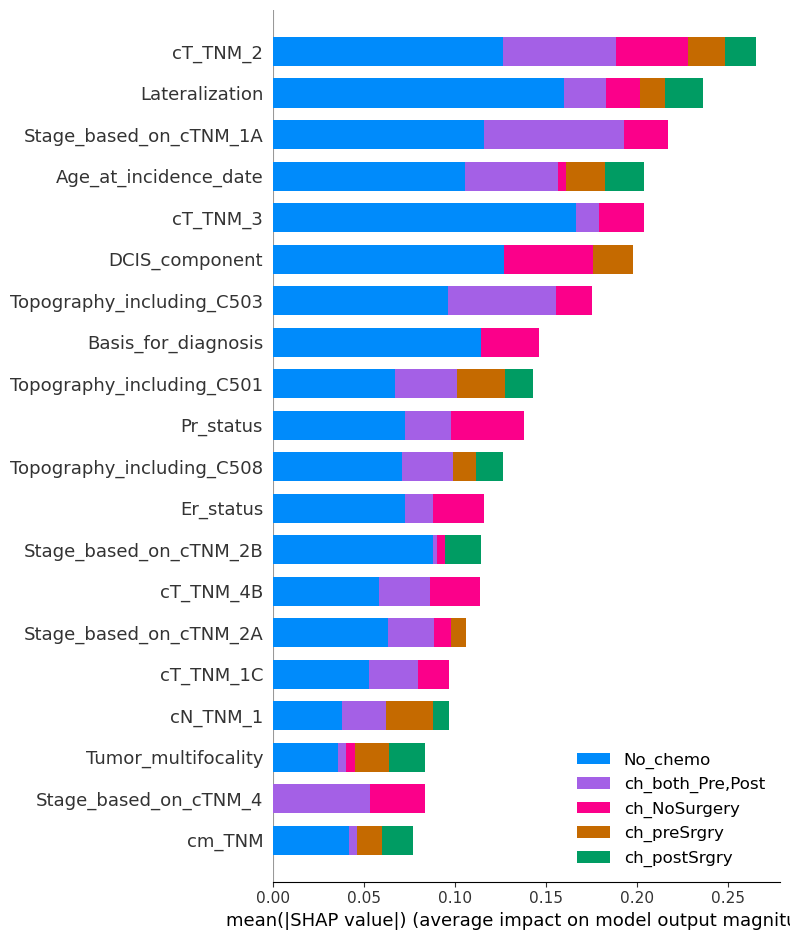

In [165]:
shap.summary_plot(shap_values, features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

plt.show()

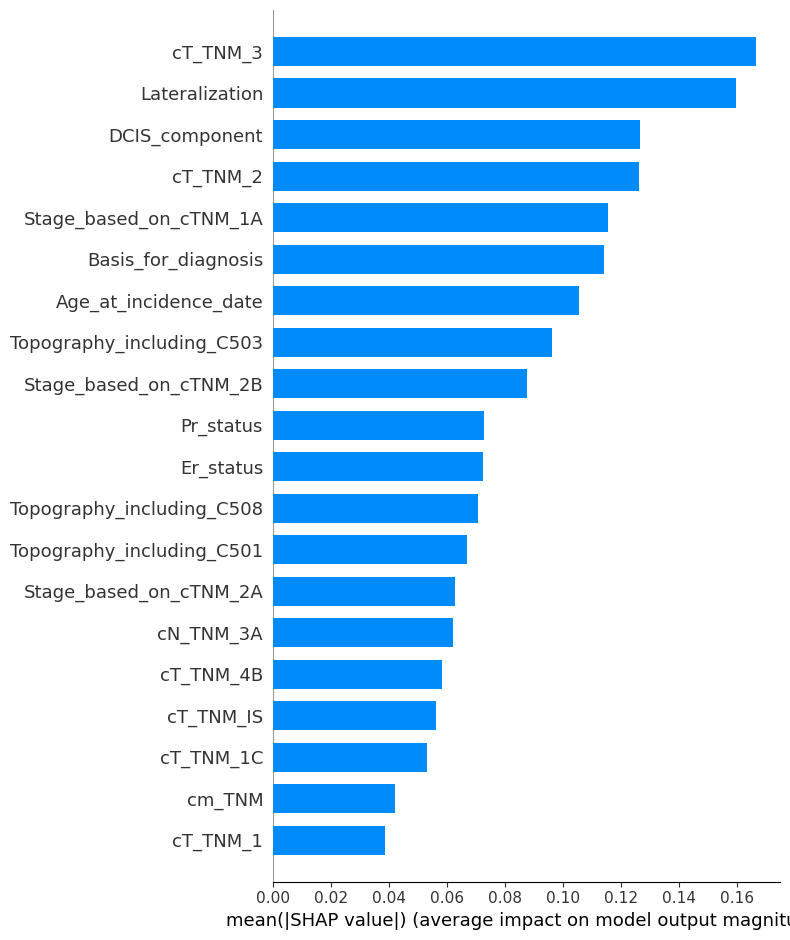

In [168]:
shap.summary_plot(shap_values[Predicted_class], features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

plt.show()

In [65]:
# plot the SHAP values for the Setosa output of the first instance
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[1], :])[0]}')

print(f'length of SHAP values: {len(shap_values)}')
print(f'Shape of each element: {shap_values[0].shape}')





Prediction for 1st sample in X_test: [0.57  0.365 0.065 0.    0.   ]
length of SHAP values: 5
Shape of each element: (200, 46)


In [89]:
shap_values[3]

array([[-4.47612999e-02,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00, -1.95415876e-02, -1.05314829e-02,
         0.00000000e+00,  0.00000000e+00, -2.53069703e-02,
        -5.90704335e-03, -1.39046796e-03,  0.00000000e+00,
         1.94367621e-02,  1.59019660e-03,  0.00000000e+00,
        -2.12529115e-02,  0.00000000e+00,  0.00000000e+00,
        -1.01096759e-02,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00, -1.81195750e-02, -2.05657110e-02,
        -2.57021199e-03,  2.02091294e-02, -8.96973295e-03,
         0.00000000e+00, -2.92105147e-04, -6.32214153e-04,
         0.00000000e+00,  5.78982427e-03,  2.01571683e-02,
         0.00000000e+00,  0.00000000e+00,  1.32256685e-02,
        -1.26400832e-02,  0.00000000e+00, -5.16934057e-02,
         0.00000000e+00, -1.49259219e-02, -4.41986548e-03,
         0.00000000e+00,  0.00000000e+00,  1.14115167e-02,
         0.00000000e+00],
       [-7.34475329e-03,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00, -3.90

In [66]:
shap.summary_plot(shap_values[0][0,:], features=sample, feature_names=X.columns, class_names=classes_names[y_test.name], plot_type="bar", show=False)

plt.show()

AssertionError: Summary plots need a matrix of shap_values, not a vector.

In [98]:
rf.predict_proba(x_test.iloc[[1], :])

array([[0.935, 0.01 , 0.055, 0.   , 0.   ]])

In [100]:
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[1], :])[0]}')

Prediction for 1st sample in X_test: [0.935 0.01  0.055 0.    0.   ]


In [489]:
# Create a LIME explainer

x_train=my_dictionary['x_train']
x_test=my_dictionary['x_test']
y_train=my_dictionary['y_train']
y_test=my_dictionary['y_test']
rf.predict_proba=my_dictionary['rf_prob']    

explainer = LimeTabularExplainer(x_train.values, 
                                 feature_names=x_train.columns, 
                                 class_names=['chemo_0','chemo_1','chemo_2','chemo_3','chemo_4'], 
                                 discretize_continuous=True)

# Choose a sample to explain
i = 0
sample = x_test.iloc[i].values.reshape(1, -1)
print(f'Actual class: {y_test[i]}')
print(f'Predicted class: {rf.predict(sample)[0]}')

# Explain the prediction for the chosen sample
explanation = explainer.explain_instance(sample[0], rf.predict_proba, num_features=30, top_labels=10)


# Visualize the explanation
explanation.show_in_notebook(show_table=True, show_all=False)



NameError: name 'my_dictionary' is not defined

In [ ]:
lime_local = explainer.explain_local(x_test[-20:], 
                                y_test[-20:], 
                                name='LIME')

In [ ]:
from interpret.blackbox import LimeTabular
# %% Apply lime
# Initilize Lime for Tabular data
lime = LimeTabular(rf.predict_proba, 
                   data=x_train, 
                   random_state=1)
# Get local explanations
lime_local = lime.explain_local(x_test[-20:], 
                                y_test[-20:], 
                                name='LIME')

show(lime_local)

In [ ]:
data.chemo.value_counts()

In [ ]:
aa=data.chemo.value_counts() 

In [ ]:
aa

In [ ]:
class_imbalance [chemo
0    0.619691
2    0.226297
1    0.129258
3    0.013895
4    0.010858
Name: count, dtype: float64, target
0    0.853607
2    0.055227
3    0.052442
1    0.023614
4    0.015110
Name: count, dtype: float64, hormonal
2    0.500835
0    0.400127
4    0.065351
3    0.027284
1    0.006403
Name: count, dtype: float64, radio
2    0.641787
0    0.318704
1    0.021387
4    0.018122
Name: count, dtype: float64, surgery
0    0.907441
1    0.092559
Name: count, dtype: float64]

In [ ]:
# plot the SHAP values for the Setosa output of the first instance
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[0], :])[0]}')

#pridiction probabilites of this single instance, x_test.iloc[0,:
print(explainer.expected_value)

shap.force_plot(
    explainer.expected_value[0], shap_values[0][0,:], x_test.iloc[0,:], link="logit", 
    matplotlib=True # <-- 
) 


In [ ]:
print(explainer.expected_value)
shap.force_plot(
    explainer.expected_value[1], shap_values[1][0,:], x_test.iloc[0,:], link="logit", 
    matplotlib=True # <-- 
) 


In [ ]:
shap_values[1][0,:]

In [ ]:
shap_values

In [ ]:
shap.summary_plot(shap_values, x_test)

In [ ]:
print(shap_values[1][0,:])

In [ ]:
rf.predict_proba(x_test.iloc[[0], :])[0]

In [ ]:
start_index = 1
end_index = 10
shap_values = explainer.shap_values(x_test[start_index:end_index], nsamples=100, l1_reg="num_features(28)")


In [ ]:
# plot the SHAP values for the Setosa output of the first instance
print(f'Prediction for 1st sample in X_test: {rf.predict_proba(x_test.iloc[[0], :])[0]}')

#pridiction probabilites of this single instance, x_test.iloc[0,:
print(explainer.expected_value)

shap.force_plot(
    explainer.expected_value[0], shap_values[0][0,:], x_test.iloc[0,:], link="logit", 
    matplotlib=True # <-- 
) 


In [ ]:
print(explainer.expected_value)
shap.force_plot(
    explainer.expected_value[1], shap_values[1][0,:], x_test.iloc[0,:], link="logit", 
    matplotlib=True # <-- 
) 


In [ ]:

explainer.expected_value

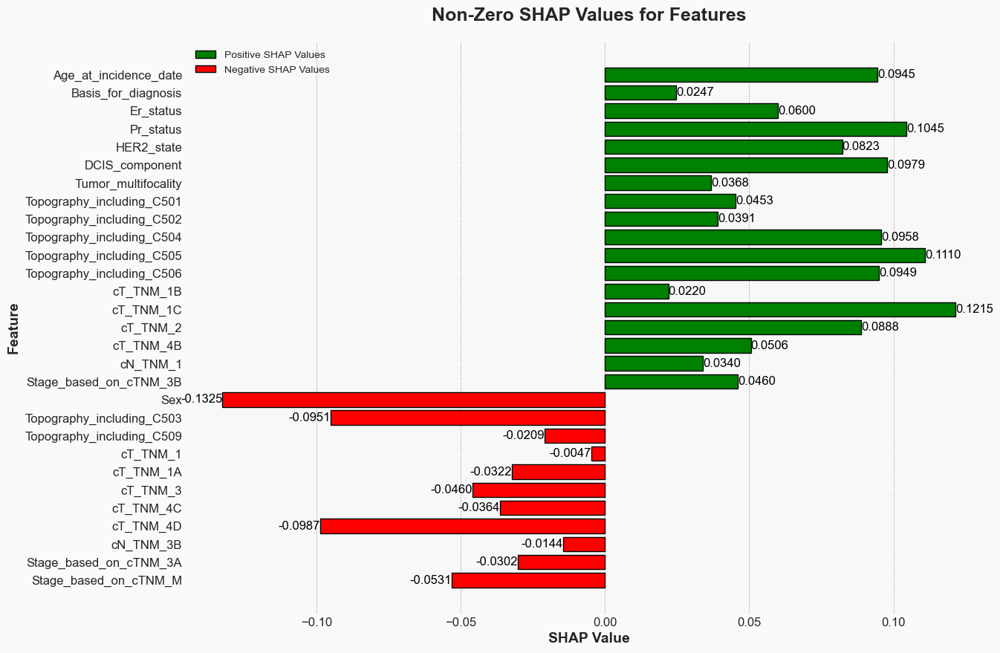

In [385]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names
shap_valuesss = np.array([[ 0.09448379, -0.13254803,  0.        ,  0.02471993,  0.        ,
         0.        ,  0.        ,  0.06002808,  0.10454518,  0.08227607,
         0.09786801,  0.03683819,  0.04533723,  0.03908481, -0.09507114,
         0.09579643,  0.11100852,  0.09494059,  0.        , -0.02087526,
        -0.00466435, -0.03216771,  0.02197531,  0.12145945,  0.        ,
         0.08884367, -0.04598742,  0.        ,  0.05056371, -0.03640725,
        -0.09867409,  0.        ,  0.03400387,  0.        ,  0.        ,
         0.        , -0.01438918,  0.        ,  0.        ,  0.        ,
         0.        , -0.03021992,  0.04598459,  0.        ,  0.        ,
        -0.05305681]])
column_names = [
    'Age_at_incidence_date', 'Sex', 'Tumor_type', 'Basis_for_diagnosis',
    'Lateralization', 'Morphology', 'cm_TNM', 'Er_status', 'Pr_status',
    'HER2_state', 'DCIS_component', 'Tumor_multifocality',
    'Topography_including_C501', 'Topography_including_C502',
    'Topography_including_C503', 'Topography_including_C504',
    'Topography_including_C505', 'Topography_including_C506',
    'Topography_including_C508', 'Topography_including_C509', 'cT_TNM_1',
    'cT_TNM_1A', 'cT_TNM_1B', 'cT_TNM_1C', 'cT_TNM_1M', 'cT_TNM_2',
    'cT_TNM_3', 'cT_TNM_4A', 'cT_TNM_4B', 'cT_TNM_4C', 'cT_TNM_4D',
    'cT_TNM_IS', 'cN_TNM_1', 'cN_TNM_2A', 'cN_TNM_2B', 'cN_TNM_3A',
    'cN_TNM_3B', 'cN_TNM_3C', 'Stage_based_on_cTNM_1A',
    'Stage_based_on_cTNM_2A', 'Stage_based_on_cTNM_2B',
    'Stage_based_on_cTNM_3A', 'Stage_based_on_cTNM_3B',
    'Stage_based_on_cTNM_3C', 'Stage_based_on_cTNM_4',
    'Stage_based_on_cTNM_M']

# Flatten shap_valuesss array
shap_valuesss = shap_valuesss.flatten()

# Filter non-zero SHAP values
non_zero_indices = np.where(shap_valuesss != 0)[0]
non_zero_shap_values = shap_valuesss[non_zero_indices]
non_zero_shap_columns = np.array(column_names)[non_zero_indices]

# Separate positive and negative SHAP values
positive_indices = np.where(non_zero_shap_values > 0)[0]
negative_indices = np.where(non_zero_shap_values < 0)[0]

positive_shap_values = non_zero_shap_values[positive_indices]
negative_shap_values = non_zero_shap_values[negative_indices]

positive_shap_columns = non_zero_shap_columns[positive_indices]
negative_shap_columns = non_zero_shap_columns[negative_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(14, 10), facecolor='#f7f7f7')

# Create a gradient background
ax.set_facecolor('#f7f7f7')
ax.patch.set_facecolor('#f7f7f7')
fig.patch.set_facecolor('#f7f7f7')

# Plot positive and negative SHAP values
bars_positive = ax.barh(positive_shap_columns, positive_shap_values, color='green', edgecolor='black', label='Positive SHAP Values')
bars_negative = ax.barh(negative_shap_columns, negative_shap_values, color='red', edgecolor='black', label='Negative SHAP Values')

# Add value labels
for bar in bars_positive:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left', fontsize=12, color='black')

for bar in bars_negative:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='right', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('SHAP Value', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Non-Zero SHAP Values for Features', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add legend
ax.legend()

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


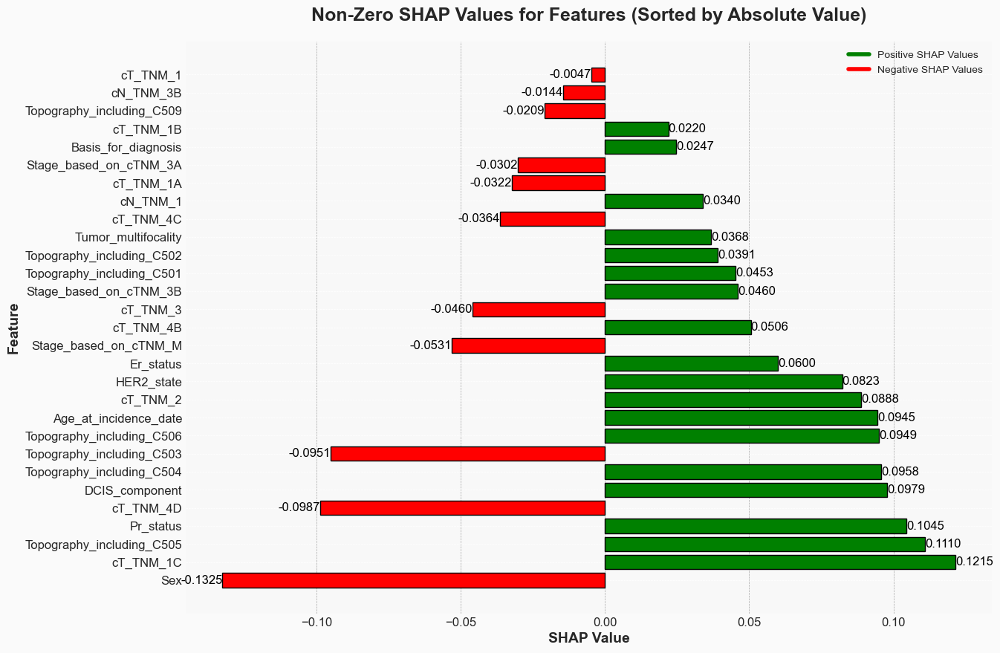

In [387]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names
shap_valuesss = np.array([[ 0.09448379, -0.13254803,  0.        ,  0.02471993,  0.        ,
         0.        ,  0.        ,  0.06002808,  0.10454518,  0.08227607,
         0.09786801,  0.03683819,  0.04533723,  0.03908481, -0.09507114,
         0.09579643,  0.11100852,  0.09494059,  0.        , -0.02087526,
        -0.00466435, -0.03216771,  0.02197531,  0.12145945,  0.        ,
         0.08884367, -0.04598742,  0.        ,  0.05056371, -0.03640725,
        -0.09867409,  0.        ,  0.03400387,  0.        ,  0.        ,
         0.        , -0.01438918,  0.        ,  0.        ,  0.        ,
         0.        , -0.03021992,  0.04598459,  0.        ,  0.        ,
        -0.05305681]])
column_names = [
    'Age_at_incidence_date', 'Sex', 'Tumor_type', 'Basis_for_diagnosis',
    'Lateralization', 'Morphology', 'cm_TNM', 'Er_status', 'Pr_status',
    'HER2_state', 'DCIS_component', 'Tumor_multifocality',
    'Topography_including_C501', 'Topography_including_C502',
    'Topography_including_C503', 'Topography_including_C504',
    'Topography_including_C505', 'Topography_including_C506',
    'Topography_including_C508', 'Topography_including_C509', 'cT_TNM_1',
    'cT_TNM_1A', 'cT_TNM_1B', 'cT_TNM_1C', 'cT_TNM_1M', 'cT_TNM_2',
    'cT_TNM_3', 'cT_TNM_4A', 'cT_TNM_4B', 'cT_TNM_4C', 'cT_TNM_4D',
    'cT_TNM_IS', 'cN_TNM_1', 'cN_TNM_2A', 'cN_TNM_2B', 'cN_TNM_3A',
    'cN_TNM_3B', 'cN_TNM_3C', 'Stage_based_on_cTNM_1A',
    'Stage_based_on_cTNM_2A', 'Stage_based_on_cTNM_2B',
    'Stage_based_on_cTNM_3A', 'Stage_based_on_cTNM_3B',
    'Stage_based_on_cTNM_3C', 'Stage_based_on_cTNM_4',
    'Stage_based_on_cTNM_M']

# Flatten shap_valuesss array
shap_valuesss = shap_valuesss.flatten()

# Filter non-zero SHAP values
non_zero_indices = np.where(shap_valuesss != 0)[0]
non_zero_shap_values = shap_valuesss[non_zero_indices]
non_zero_shap_columns = np.array(column_names)[non_zero_indices]

# Sort by absolute values
sorted_indices = np.argsort(np.abs(non_zero_shap_values))
sorted_shap_values = non_zero_shap_values[sorted_indices]
sorted_shap_columns = non_zero_shap_columns[sorted_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(14, 10), facecolor='#f7f7f7')

# Create a gradient background
ax.set_facecolor('#f7f7f7')
ax.patch.set_facecolor('#f7f7f7')
fig.patch.set_facecolor('#f7f7f7')

# Plot SHAP values
bars = ax.barh(sorted_shap_columns, sorted_shap_values, color=['green' if x > 0 else 'red' for x in sorted_shap_values], edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left' if bar.get_width() > 0 else 'right', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('SHAP Value', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Non-Zero SHAP Values for Features (Sorted by Absolute Value)', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add legend
positive_patch = plt.Line2D([0], [0], color='green', lw=4, label='Positive SHAP Values')
negative_patch = plt.Line2D([0], [0], color='red', lw=4, label='Negative SHAP Values')
ax.legend(handles=[positive_patch, negative_patch])

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


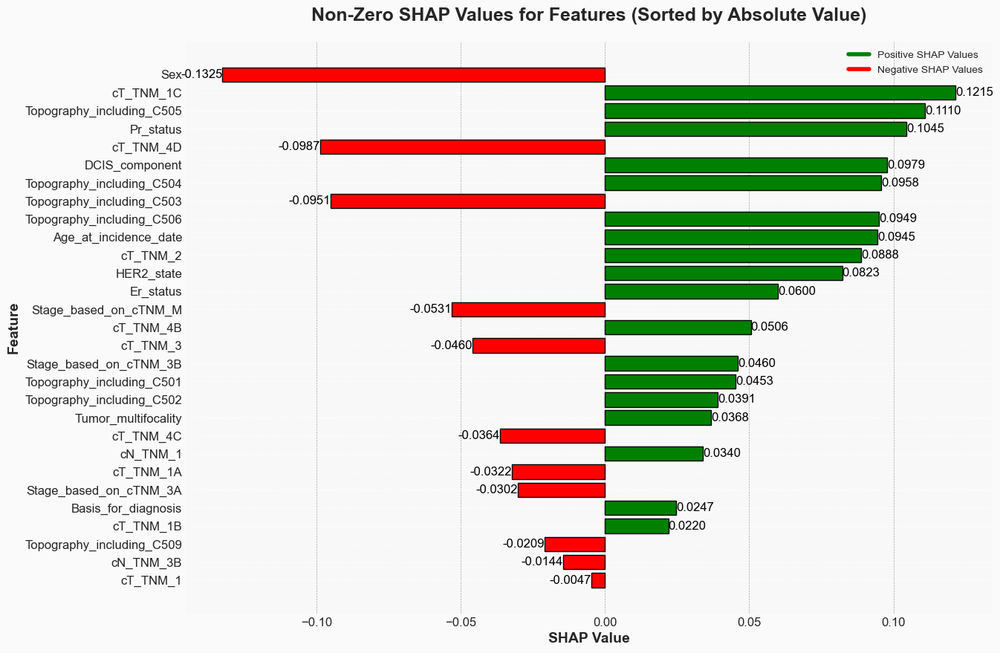

In [388]:
import numpy as np
import matplotlib.pyplot as plt

# Provided SHAP values and column names
shap_valuesss = np.array([[ 0.09448379, -0.13254803,  0.        ,  0.02471993,  0.        ,
         0.        ,  0.        ,  0.06002808,  0.10454518,  0.08227607,
         0.09786801,  0.03683819,  0.04533723,  0.03908481, -0.09507114,
         0.09579643,  0.11100852,  0.09494059,  0.        , -0.02087526,
        -0.00466435, -0.03216771,  0.02197531,  0.12145945,  0.        ,
         0.08884367, -0.04598742,  0.        ,  0.05056371, -0.03640725,
        -0.09867409,  0.        ,  0.03400387,  0.        ,  0.        ,
         0.        , -0.01438918,  0.        ,  0.        ,  0.        ,
         0.        , -0.03021992,  0.04598459,  0.        ,  0.        ,
        -0.05305681]])
column_names = [
    'Age_at_incidence_date', 'Sex', 'Tumor_type', 'Basis_for_diagnosis',
    'Lateralization', 'Morphology', 'cm_TNM', 'Er_status', 'Pr_status',
    'HER2_state', 'DCIS_component', 'Tumor_multifocality',
    'Topography_including_C501', 'Topography_including_C502',
    'Topography_including_C503', 'Topography_including_C504',
    'Topography_including_C505', 'Topography_including_C506',
    'Topography_including_C508', 'Topography_including_C509', 'cT_TNM_1',
    'cT_TNM_1A', 'cT_TNM_1B', 'cT_TNM_1C', 'cT_TNM_1M', 'cT_TNM_2',
    'cT_TNM_3', 'cT_TNM_4A', 'cT_TNM_4B', 'cT_TNM_4C', 'cT_TNM_4D',
    'cT_TNM_IS', 'cN_TNM_1', 'cN_TNM_2A', 'cN_TNM_2B', 'cN_TNM_3A',
    'cN_TNM_3B', 'cN_TNM_3C', 'Stage_based_on_cTNM_1A',
    'Stage_based_on_cTNM_2A', 'Stage_based_on_cTNM_2B',
    'Stage_based_on_cTNM_3A', 'Stage_based_on_cTNM_3B',
    'Stage_based_on_cTNM_3C', 'Stage_based_on_cTNM_4',
    'Stage_based_on_cTNM_M']

# Flatten shap_valuesss array
shap_valuesss = shap_valuesss.flatten()

# Filter non-zero SHAP values
non_zero_indices = np.where(shap_valuesss != 0)[0]
non_zero_shap_values = shap_valuesss[non_zero_indices]
non_zero_shap_columns = np.array(column_names)[non_zero_indices]

# Sort by absolute values in descending order
sorted_indices = np.argsort(-np.abs(non_zero_shap_values))  # Note the negative sign to sort in descending order
sorted_shap_values = non_zero_shap_values[sorted_indices]
sorted_shap_columns = non_zero_shap_columns[sorted_indices]

# Create the horizontal bar plot
fig, ax = plt.subplots(figsize=(14, 10), facecolor='#f7f7f7')

# Create a gradient background
ax.set_facecolor('#f7f7f7')
ax.patch.set_facecolor('#f7f7f7')
fig.patch.set_facecolor('#f7f7f7')

# Plot SHAP values
bars = ax.barh(sorted_shap_columns, sorted_shap_values, color=['green' if x > 0 else 'red' for x in sorted_shap_values], edgecolor='black')

# Add value labels
for bar in bars:
    ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.4f}', va='center', ha='left' if bar.get_width() > 0 else 'right', fontsize=12, color='black')

# Invert y-axis to have the highest value at the top
ax.invert_yaxis()

# Add titles and labels
ax.set_xlabel('SHAP Value', fontsize=14, weight='bold')
ax.set_ylabel('Feature', fontsize=14, weight='bold')
ax.set_title('Non-Zero SHAP Values for Features (Sorted by Absolute Value)', fontsize=18, weight='bold', pad=20)

# Show gridlines
ax.grid(True, which='major', linestyle='--', linewidth=0.5)

# Customize ticks
ax.xaxis.set_tick_params(labelsize=12)
ax.yaxis.set_tick_params(labelsize=12)

# Add legend
positive_patch = plt.Line2D([0], [0], color='green', lw=4, label='Positive SHAP Values')
negative_patch = plt.Line2D([0], [0], color='red', lw=4, label='Negative SHAP Values')
ax.legend(handles=[positive_patch, negative_patch])

# Add a background gradient
fig.patch.set_alpha(0.5)
ax.patch.set_alpha(0.5)
plt.grid(axis='x', color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

plt.show()


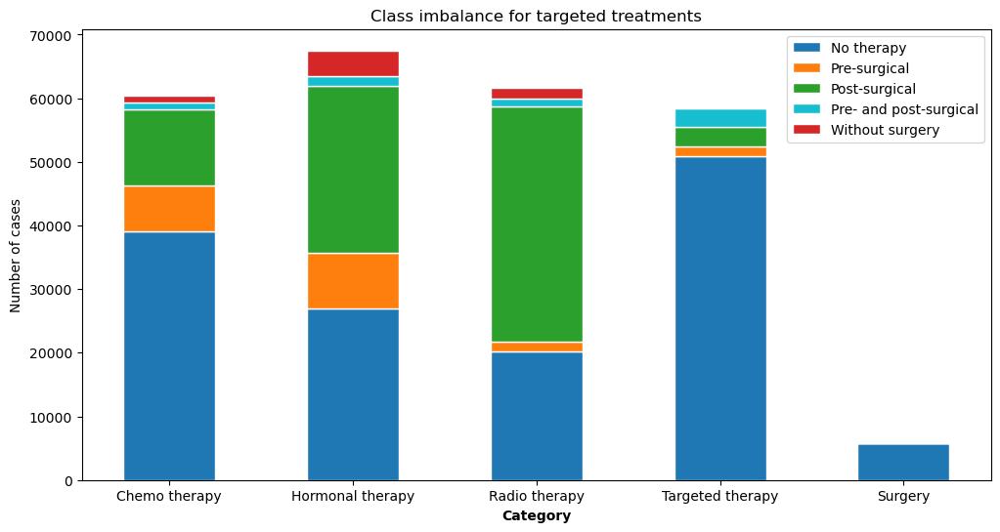

In [1]:
import matplotlib.pyplot as plt
import numpy as np

# Sample data (replace this with your actual data)
categories = ['Chemo therapy', 'Targeted therapy' 'Hormonal therapy', 'Radio therapy', 'Surgery']
no_therapy = [39145, 26977, 20277, 50889, 5728]
pre_surgical = [7187, 8674, 1532, 1490, 0]
post_surgical = [11909, 26328, 36875, 3183, 0]
pre_and_post_surgical = [1125, 1433, 1316, 2834, 0]
without_surgery = [1023, 4098, 1604, 0, 0]

# Bar width
barWidth = 0.5

# Set position of bar on X axis
r = np.arange(len(categories))

# Create figure
plt.figure(figsize=(12, 6))

# Make the plot
plt.bar(r, no_therapy, color='#1f77b4', edgecolor='white', width=barWidth, label='No therapy')
plt.bar(r, pre_surgical, bottom=no_therapy, color='#ff7f0e', edgecolor='white', width=barWidth, label='Pre-surgical')
plt.bar(r, post_surgical, bottom=np.array(no_therapy) + np.array(pre_surgical), color='#2ca02c', edgecolor='white', width=barWidth, label='Post-surgical')
plt.bar(r, pre_and_post_surgical, bottom=np.array(no_therapy) + np.array(pre_surgical) + np.array(post_surgical), color='#17becf', edgecolor='white', width=barWidth, label='Pre- and post-surgical')
plt.bar(r, without_surgery, bottom=np.array(no_therapy) + np.array(pre_surgical) + np.array(post_surgical) + np.array(pre_and_post_surgical), color='#d62728', edgecolor='white', width=barWidth, label='Without surgery')

# Add xticks on the middle of the group bars
plt.xlabel('Category', fontweight='bold')
plt.xticks(r, categories)
plt.ylabel('Number of cases')
plt.title('Class imbalance for targeted treatments')

# Create legend & Show graphic
plt.legend()
plt.show()

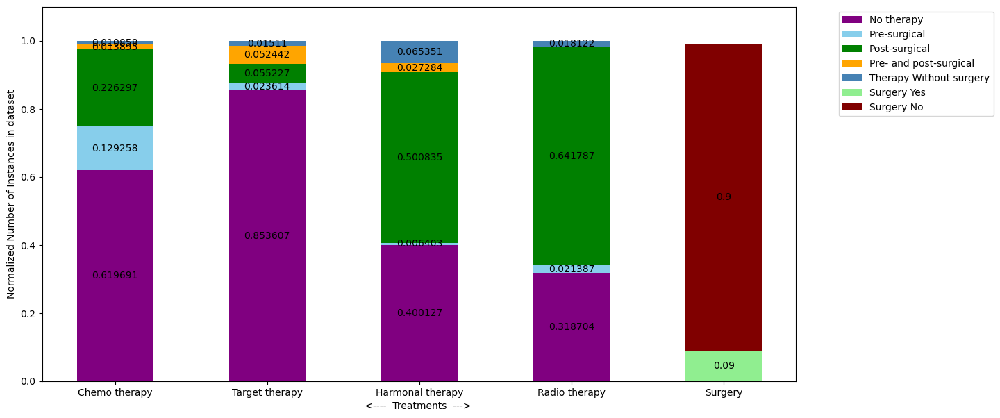

In [44]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Sample data based on the provided image
data = {
    'Treatment': ['Chemo therapy', 'Target therapy', 'Harmonal therapy', 'Radio therapy', 'Surgery'],
    'No therapy': [0.619691,0.853607,0.400127,0.318704,0],
    'Pre-surgical': [0.129258,0.023614,0.006403,0.021387,0],
    'Post-surgical': [0.226297,0.055227,0.500835,0.641787,0],
    'Pre- and post-surgical': [0.013895,0.052442,0.027284,0,0],
    'Therapy Without surgery': [0.010858,0.01511,0.065351,0.018122,0],
    
    
    
    'Surgery Yes': [0, 0, 0, 0, 0.09],
    'Surgery No': [0, 0, 0, 0, 0.9]
}

# Create DataFrame
df = pd.DataFrame(data)
df.set_index('Treatment', inplace=True)

# Plot
fig, ax = plt.subplots(figsize=(14, 7))

# Define colors
colors = ['purple', 'skyblue', 'green', 'orange', 'steelblue', 'lightgreen', 'maroon']

# Define bar width
bar_width = 0.5

# Stack the bars
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    ax.bar(df.index, df[col], bottom=bottom, color=colors[i], label=col, width=bar_width)
    bottom += df[col]

# Add labels
bottom = np.zeros(len(df))
for i, col in enumerate(df.columns):
    for j, value in enumerate(df[col]):
        if value > 0:
            ax.text(j, bottom[j] + value / 2, f"{value}", ha='center', va='center', fontsize=10)
    bottom += df[col]

# Customizing the plot
ax.set_xlabel(' <----  Treatments  --->  ')
ax.set_ylabel('Normalized Number of Instances in dataset')
#ax.set_title('Number of Instances by Treatment and Surgery Status')
ax.set_ylim(0, 1.1)

# Adjust legend position inside the plot
ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1))

plt.xticks(rotation=0)
#plt.tight_layout(rect=[0, 0, 1, 1])  # Adjust layout to fit legend
plt.show()
